This notebook Generates the figures illustrating the sub-clusters of astrocyte

In [1]:
import numpy as np
import seaborn as sns 
import matplotlib.pyplot as plt
import anndata
import pandas as pd
import scanpy as sc
import rapids_singlecell as rsc

- Function for spatial plot

In [2]:
def plot_cluster_scdata(scdata,cmap,all_clusters,clusters=[1,2],bg_color = 'gray',bg_pt_size = 5, point_sz_map = None, transpose=1,flipx=1,flipy=1,hue_input = 'leiden' , ax = None,use_seaborn = False,show_title = True):
    """
    plot spatial location of cell cluster using either seaborn or matplotlib
    use seaborn for individual clusters
    use matplotlib scatter function to visualize all clusters
    cmap - dictionary that has color of each cluster  used in umap
    """
    fig = None
    if not ax:
     fig,ax = plt.subplots(figsize=(15, 15),)# facecolor="black")

    
    if use_seaborn:
        x,y,hue = 'x', 'y',hue_input
        sns.scatterplot(x=x, y=y, data=scdata.obs, 
                        s=bg_pt_size, markers=dict(marker_edge_color='none'),
                        rasterized=True,
                        ax=ax,c= bg_color)
    else: # use matplotlib
        x,y = (np.array(scdata.obs[['x', 'y']])*[flipx,flipy])[:,::transpose].T
        ax.scatter(x, y, c=bg_color, s = bg_pt_size, marker='.')
        
    for cluster in clusters:
        clst_idx = all_clusters.index(cluster)
        cluster_ = str(cluster)
        inds = scdata.obs[hue_input] == cluster_
        
        #col = cmap[int(clst_idx) % len(cmap)]
        col = cmap[cluster_] # cmap is dictionary
        point_sz = point_sz_map[cluster_] # point size dictionary
        if use_seaborn:
            sns.scatterplot(x=x, y=y, data=scdata.obs[inds], 
                        s=point_sz, markers=dict(marker_edge_color=col),
                        rasterized=True,
                        ax=ax,c= col)
            if show_title:
                ax.set_title(f'cluster {cluster_}',fontsize = 7, y= 1)
        else:
            x_ = x[inds]
            y_ = y[inds]
            ax.scatter(x_, y_, c=col, s= point_sz, marker='.',label = cluster_)
        
        
    
    # ax.set_xlim([x.min(),x.max()])
    # ax.set_ylim([y.min(),y.max()])
    ax.grid(False)
    ax.axis("off")
    ax.axis("equal")
    if fig:
        ax.legend( loc = 'lower center', ncol = len(clusters)//3,markerscale = 12, title = 'Clusters',facecolor = 'black',
            labelcolor = 'white')
        ax.set_title(np.unique(scdata.obs['sample'])[0])
    else:
        # ax.legend( loc = 'lower center')
        pass
        
    ax.autoscale(enable=True, tight=True)


In [3]:
def rotate(spatial_x,deg):
    """
    spatial_X: Nx2 matrix
    deg: rotation degree in radian
    
    """
    deg = np.deg2rad(deg)
    rotation_mat = np.array([[np.cos(deg),-1*np.sin(deg)],
                            [np.sin(deg),np.cos(deg)]])
    return np.matmul(spatial_x,rotation_mat)

- Load the astorcyte clustering result 

In [6]:
astro_adata_original = anndata.read_h5ad(r'./astrocyte_subclustering.h5ad')
astro_adata_original

AnnData object with n_obs × n_vars = 319738 × 123
    obs: 'volm', 'leiden', 'Neighborhood_label', 'Neighborhood_name', 'Neighborhood_bootstrapping_probability', 'Class_label', 'Class_name', 'Class_bootstrapping_probability', 'Subclass_label', 'Subclass_name', 'Subclass_bootstrapping_probability', 'Group_label', 'Group_name', 'Group_bootstrapping_probability', 'Cluster_label', 'Cluster_name', 'Cluster_alias', 'Cluster_bootstrapping_probability', 'Final_Major_region_label', 'MatrixStriosome_label', 'samples', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'x', 'y', 'Astro_subtype'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mean', 'std'
    uns: 'Astro_subtype_colors', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups'

In [7]:
np.unique(astro_adata_original.obs['Astro_subtype'])

array(['Astro_unk', 'GP-TH_Astro', 'ImAstro', 'STR_Astro-1',
       'STR_Astro-2', 'Vascular_Astro', 'WM_Astro'], dtype=object)

In [18]:
# remove the Immune-Astro and Astro-unk cluster 
keep = ~(astro_adata_original.obs['Astro_subtype'].isin(['Astro_unk'])) 
final_filtered_adata = astro_adata_original[keep].copy()
final_filtered_adata

AnnData object with n_obs × n_vars = 289805 × 123
    obs: 'volm', 'leiden', 'Neighborhood_label', 'Neighborhood_name', 'Neighborhood_bootstrapping_probability', 'Class_label', 'Class_name', 'Class_bootstrapping_probability', 'Subclass_label', 'Subclass_name', 'Subclass_bootstrapping_probability', 'Group_label', 'Group_name', 'Group_bootstrapping_probability', 'Cluster_label', 'Cluster_name', 'Cluster_alias', 'Cluster_bootstrapping_probability', 'Final_Major_region_label', 'MatrixStriosome_label', 'samples', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'x', 'y', 'Astro_subtype'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mean', 'std'
    uns: 'Astro_subtype_colors', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups'

In [8]:
np.unique(astro_adata_original.obs['Astro_subtype'])

array(['Astro_unk', 'GP-TH_Astro', 'ImAstro', 'STR_Astro-1',
       'STR_Astro-2', 'Vascular_Astro', 'WM_Astro'], dtype=object)

In [9]:
np.unique(final_filtered_adata.obs['Astro_subtype'])

array(['GP-TH_Astro', 'ImAstro', 'STR_Astro-1', 'STR_Astro-2',
       'Vascular_Astro', 'WM_Astro'], dtype=object)

### 1. Compute Proportion of the astrocyte subtypes 

In [10]:
# update the green color to cyan
cluster_cmap = {nm:clr for nm,clr in zip(final_filtered_adata.obs.Astro_subtype.cat.categories, final_filtered_adata.uns['Astro_subtype_colors'])}
cluster_cmap['STR_Astro-1'] = "#c276057b"

In [11]:
cluster_cmap

{'GP-TH_Astro': '#e6194b',
 'STR_Astro-1': '#c276057b',
 'STR_Astro-2': '#ffe119',
 'Vascular_Astro': '#4363d8',
 'ImAstro': '#911eb4',
 'WM_Astro': '#42d4f4'}

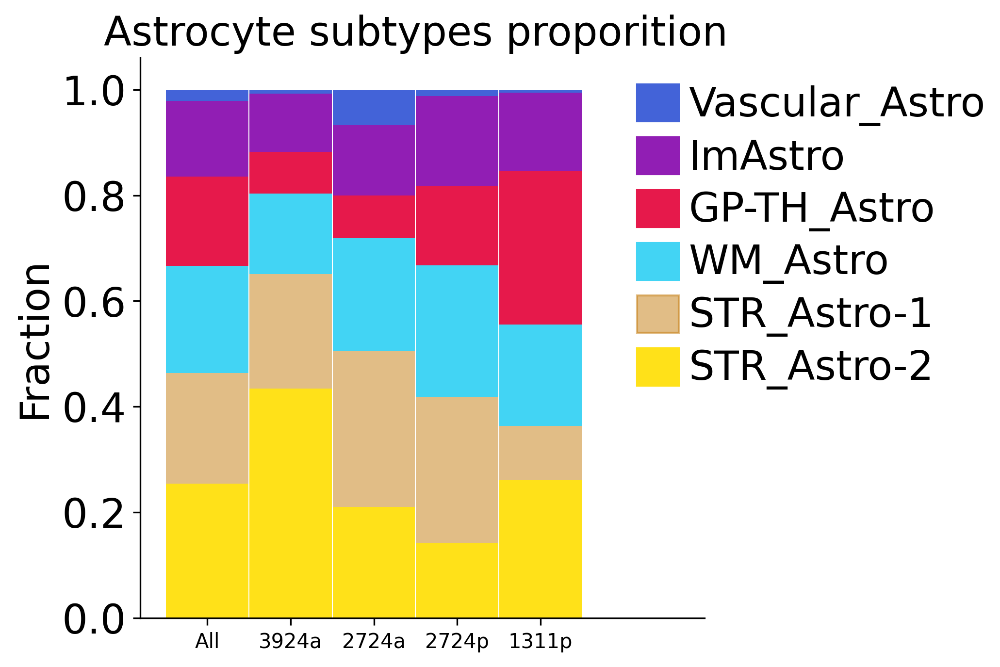

In [14]:
# first get the overall proporition
import matplotlib as mpl
mpl.rcParams['font.size'] = 20
adata_obs = final_filtered_adata.obs.copy()

# # remove unused cell types,
celltype_cols = [nm for nm in adata_obs.columns if 'name' in nm.lower() ]
for nm in celltype_cols:
    adata_obs[nm] = adata_obs[nm].astype(str)
    adata_obs[nm] = adata_obs[nm].astype('category')
astro_fraction = [adata_obs['Astro_subtype'].value_counts(normalize = True).to_frame().rename(columns = {'proportion':'All'})]

# then get the per sample proporition 
for sample in ['Donor_3924_anterior','Donor_2724_anterior','Donor_2724_posterior','Donor_1311_posterior']: #np.unique(adata_MERFISH.obs['samples']):

    adata_obs = final_filtered_adata[final_filtered_adata.obs['samples'] == sample].obs.copy()

    # # remove unused cell types,
    celltype_cols = [nm for nm in adata_obs.columns if 'name' in nm.lower() ]
    for nm in celltype_cols:
        adata_obs[nm] = adata_obs[nm].astype(str)
        adata_obs[nm] = adata_obs[nm].astype('category')
    astro_fraction += [adata_obs['Astro_subtype'].value_counts(normalize = True).to_frame().rename(columns = {'proportion':sample})]

astro_fraction = pd.concat(astro_fraction,axis = 1)

# stacked bar plot
import matplotlib.patches as patches
import os
fig,ax = plt.subplots(1,1, figsize = (5,5), dpi = 300)
bottom = np.zeros(astro_fraction.shape[-1])
width = 0.99
xlabels = [astro_fraction.columns[0]] + [x.split('_')[1] + x.split('_')[2][0] for x in astro_fraction.columns[1:]]

for idx,type_ in enumerate(astro_fraction.index):
    vals = astro_fraction.loc[type_,:].values
    ax.bar(xlabels,vals,width = width ,bottom = bottom, color =cluster_cmap[type_])
    bottom += vals

ax.grid(False)
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
# ax.set_xticks([])
ax.set_ylabel('Fraction', fontdict={'fontsize': 20})

ax.tick_params('y',which='major',labelsize = 20)
ax.tick_params('x',which='major',labelsize = 10)
# add legend 
bbox = ax.get_position()
for i,type_ in enumerate(astro_fraction.index):
    rec = patches.Rectangle([bbox.xmin +  6.5*bbox.width , 0.5*bbox.ymax + i* 0.1] , 0.5,0.07, color = cluster_cmap[type_], )
    ax.add_patch(rec)

    # add label 
    ax.text(bbox.xmin +  7.3*bbox.width , (0.5*bbox.ymax + i* 0.1) + 0.03,type_,va = 'center')

ax.set_title(f'Astrocyte subtypes proporition ', fontdict={'fontsize': 20})
plt.savefig(r'./figures/Custom_AstroCluster_Mainfigure_panels/concatenated_stackedbarplot_AstroCellType_proportion.png', bbox_inches = 'tight')
plt.savefig(r'./figures/Custom_AstroCluster_Mainfigure_panels/concatenated_stackedbarplot_AstroCellType_proportion.tif', bbox_inches = 'tight')

plt.show()

#### 2.  Generate UMAP using PAGA

In [24]:
final_filtered_adata.X = final_filtered_adata.layers['log_count']
#2. run PCA and harmoney integration 
print(r'running PCA / harmony integration ')
sc.pp.scale(final_filtered_adata, max_value=10)
sc.pp.pca(final_filtered_adata, n_comps=50)
sc.external.pp.harmony_integrate(final_filtered_adata,'samples', basis='X_pca')


running PCA / harmony integration 


2025-10-16 15:28:03,057 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-10-16 15:28:09,726 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-10-16 15:28:10,381 - harmonypy - INFO - Iteration 1 of 10
2025-10-16 15:28:59,289 - harmonypy - INFO - Iteration 2 of 10
2025-10-16 15:29:48,075 - harmonypy - INFO - Converged after 2 iterations


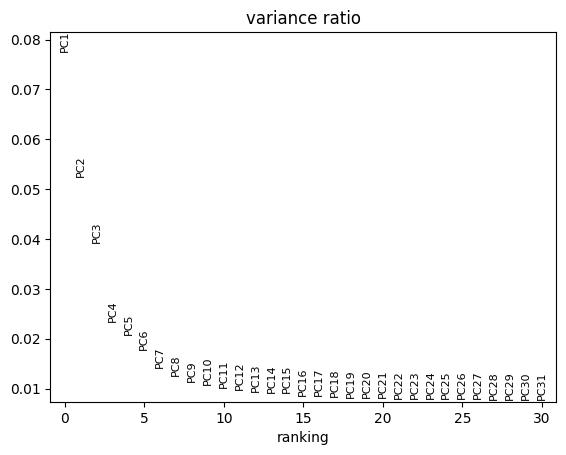

In [25]:
sc.pl.pca_variance_ratio(final_filtered_adata)

In [26]:
npcs = 15
n_neighbors = 15
# 3. compute the neighborhood graph 
print(r'Computing KNN ')
sc.pp.neighbors(final_filtered_adata, use_rep='X_pca_harmony', n_pcs=npcs, n_neighbors=n_neighbors)


Computing KNN 


In [27]:
final_filtered_adata.obs.columns

Index(['volm', 'leiden', 'Neighborhood_label', 'Neighborhood_name',
       'Neighborhood_bootstrapping_probability', 'Class_label', 'Class_name',
       'Class_bootstrapping_probability', 'Subclass_label', 'Subclass_name',
       'Subclass_bootstrapping_probability', 'Group_label', 'Group_name',
       'Group_bootstrapping_probability', 'Cluster_label', 'Cluster_name',
       'Cluster_alias', 'Cluster_bootstrapping_probability',
       'Final_Major_region_label', 'MatrixStriosome_label', 'samples',
       'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts',
       'log1p_total_counts', 'pct_counts_in_top_50_genes',
       'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes',
       'pct_counts_in_top_500_genes', 'x', 'y', 'Astro_subtype'],
      dtype='object')

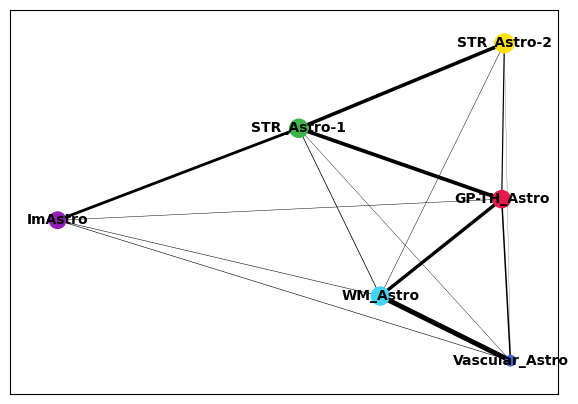

In [28]:
sc.tl.paga(final_filtered_adata, groups='Astro_subtype')
sc.pl.paga(final_filtered_adata)

In [29]:
sc.tl.umap(final_filtered_adata, init_pos='paga', min_dist = 0.1)

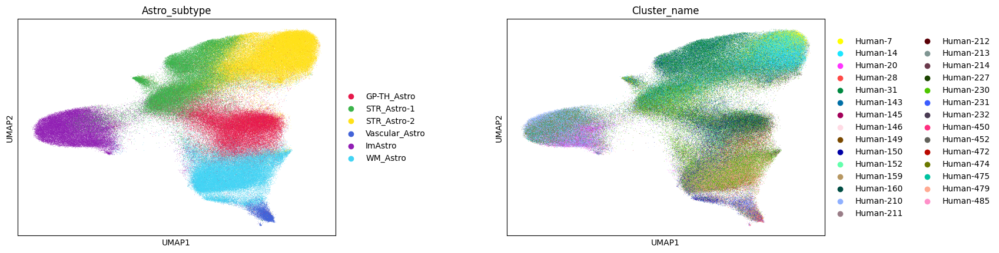

In [30]:
sc.pl.umap(final_filtered_adata, color = ['Astro_subtype','Cluster_name'],s = 1, wspace = 0.4)

### 3. Run DEG analysis to identify marker genes

In [31]:
final_filtered_adata

AnnData object with n_obs × n_vars = 289805 × 123
    obs: 'volm', 'leiden', 'Neighborhood_label', 'Neighborhood_name', 'Neighborhood_bootstrapping_probability', 'Class_label', 'Class_name', 'Class_bootstrapping_probability', 'Subclass_label', 'Subclass_name', 'Subclass_bootstrapping_probability', 'Group_label', 'Group_name', 'Group_bootstrapping_probability', 'Cluster_label', 'Cluster_name', 'Cluster_alias', 'Cluster_bootstrapping_probability', 'Final_Major_region_label', 'MatrixStriosome_label', 'samples', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'x', 'y', 'Astro_subtype'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mean', 'std'
    uns: 'Astro_subtype_colors', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups'

In [32]:
%%time
sc.tl.rank_genes_groups(final_filtered_adata,use_raw = False, groupby ='Astro_subtype', method = 'wilcoxon',layer = 'log_count')

CPU times: user 8.45 s, sys: 33.9 s, total: 42.4 s
Wall time: 1.85 s


/home/exx/.conda/envs/rapid_scanpy/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:482: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/home/exx/.conda/envs/rapid_scanpy/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:482: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/home/exx/.conda/envs/rapid_scanpy/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:482: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/home/exx/.conda/envs/rapid_scanpy/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:482: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/home/exx/.conda/envs/rapid_scanpy/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:482: RuntimeWarning: invalid value encountered in log2
  self.stats[g

In [12]:
marker = sc.get.rank_genes_groups_df(final_filtered_adata,None)
# marker = marker[(marker.pvals_adj < 0.05) & (marker.logfoldchanges > 0.5) ]
marker

,group,names,scores,logfoldchanges,pvals,pvals_adj
0,GP-TH_Astro,SLC6A11,251.842438,NaN,0.0,0.0
1,GP-TH_Astro,TNC,185.023880,NaN,0.0,0.0
2,GP-TH_Astro,MCC,174.579971,NaN,0.0,0.0
3,GP-TH_Astro,RGMA,151.579865,NaN,0.0,0.0
4,GP-TH_Astro,PTCH1,144.463593,NaN,0.0,0.0
...,...,...,...,...,...,...
733,WM_Astro,OAF,-130.820480,NaN,0.0,0.0
734,WM_Astro,SDS,-132.944473,NaN,0.0,0.0
735,WM_Astro,SPARCL1,-171.349335,NaN,0.0,0.0
736,WM_Astro,APOE,-185.752045,NaN,0.0,0.0


In [13]:
np.unique(marker.group)

array(['GP-TH_Astro', 'ImAstro', 'STR_Astro-1', 'STR_Astro-2',
       'Vascular_Astro', 'WM_Astro'], dtype=object)

In [14]:
# update the green color to cyan
cluster_cmap = {nm:clr for nm,clr in zip(final_filtered_adata.obs.Astro_subtype.cat.categories, final_filtered_adata.uns['Astro_subtype_colors'])}
cluster_cmap['STR_Astro-1'] = "#c276057b"
# update the adata .uns field for the color
final_filtered_adata.uns['Astro_subtype_colors'] = [cluster_cmap[nm] for nm in final_filtered_adata.obs['Astro_subtype'].cat.categories]


### 4. plot the Umap and gene-expression-umap for selected clusters of astrocytes

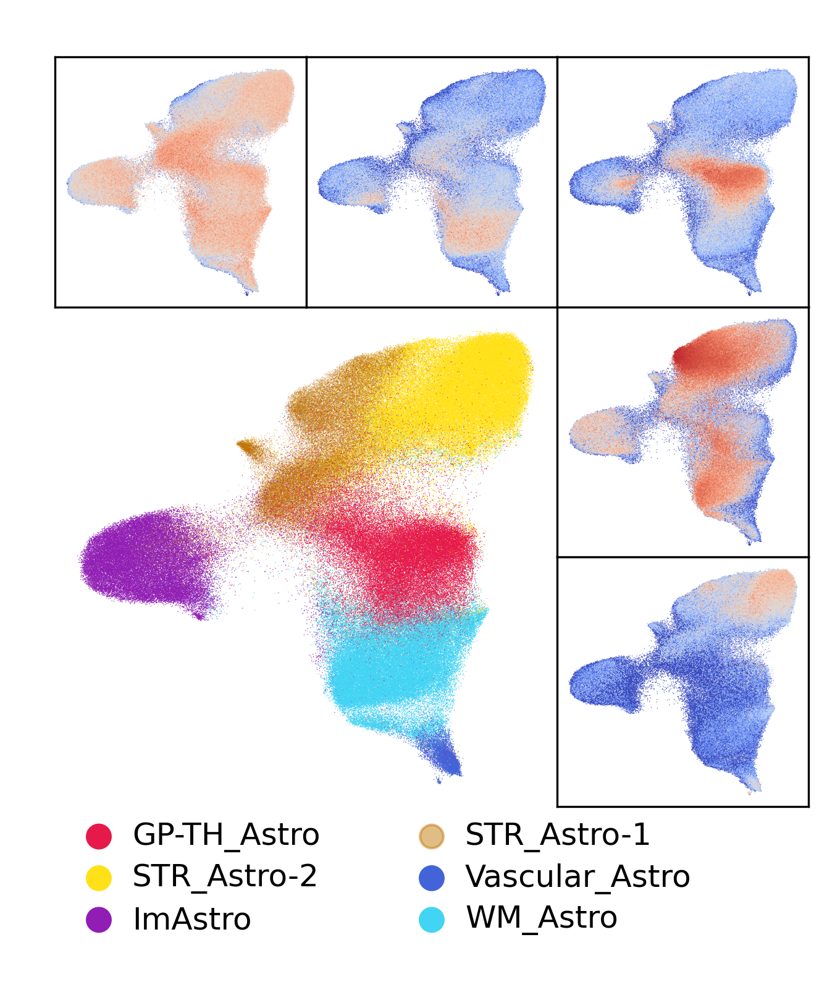

In [38]:
import matplotlib.patches as patches
import os
nogeneName = True

fig, ax = plt.subplots(1,1, dpi = 300, figsize = (3.5,3.5))

bbox = ax.get_position()
# top row axis 
top_axes = []
for i in range(3):
    top_axes +=[fig.add_axes([bbox.xmin + i*(1/2)*bbox.width,bbox.ymin + 1.*bbox.height,(1/2)*bbox.width,(1/2)*bbox.height])]

# bottom row axis 
bottom_axes = []
for i in range(2):
    bottom_axes +=[fig.add_axes([bbox.xmin + bbox.width,bbox.ymin  + i*0.5*bbox.height,(1/2)*bbox.width,(1/2)*bbox.height])]

# finally add axes for the legend
legend_ax = fig.add_axes([bbox.xmin,bbox.ymin - 0.35*bbox.height,1.5*bbox.width,(1/3)*bbox.height])


# Now fill in the axes 
# 1. Main umap
sc.pl.umap(final_filtered_adata, color = ['Astro_subtype'], show = False, ax = ax, frameon = False,legend_loc=None,
            title = ' ')
ax.set_xlabel(' ')
ax.set_ylabel(' ')


for ax_,gn in zip(top_axes,['AQP4','AQP1','SLC6A11']):
    sc.pl.umap(final_filtered_adata, color = [gn], show = False, ax = ax_, frameon = True,legend_loc=None,cmap = 'coolwarm',colorbar_loc = None,title = ' ')
    ax_.set_xlabel(' ')
    ax_.set_ylabel(' ')
    # put the title inside the box
    if not nogeneName:
        ax_.text(-1 ,9.5, gn)

for ax_,gn in zip(bottom_axes,['ADGRV1','CHI3L1']):
    sc.pl.umap(final_filtered_adata, color = [gn], show = False, ax = ax_, frameon = True,legend_loc=None,cmap = 'coolwarm',colorbar_loc = None, title = ' ')
    ax_.set_xlabel(' ')
    ax_.set_ylabel(' ')
    if not nogeneName:
        ax_.text(-1 ,11, gn)

# # add circle patche and text for the 3 cell types 
for clst_i, clst in enumerate(final_filtered_adata.obs.Astro_subtype.cat.categories):
    # yfactor = -0.5 if clst == 'STRv D1 MSN' else 0
    # xfactor = 1 if clst == 'STRv D1 MSN' else 0
    yfactor = 0
    xfactor =0
    color_rec = patches.Circle([-1.5 + 2*(clst_i%2) ,0.87 - 0.25*(clst_i//2)],0.07, color = cluster_cmap[clst])
    legend_ax.add_patch(color_rec)
    legend_ax.text(-1.5 + 2*(clst_i%2) + 0.2, 0.87 - 0.25*(clst_i//2), f'{clst}', fontsize = 12, color = 'k', va = 'center')
legend_ax.set_aspect('equal',adjustable='datalim')
# # legend_ax.set_ylim(-1.3,1)
legend_ax.set_axis_off()

# save the figure 
filename  = 'Astrocyte_umap_mainFigure'
if nogeneName:
    filename = filename + '_NoGeneName'
plt.savefig(r'./figures/Custom_AstroCluster_Mainfigure_panels' + os.sep + f'{filename}.png', bbox_inches = 'tight')
plt.savefig(r'./figures/Custom_AstroCluster_Mainfigure_panels' + os.sep + f'{filename}.tif', bbox_inches = 'tight')

plt.show()

In [ ]:
final_filtered_adata.write_h5ad(r'./final_filtered_adata_customCluster.h5ad', compression= 'gzip')

### 5. Plot the heatmap

- 5.1 Get the log1p expression for top marker genes

In [15]:
np.unique(final_filtered_adata.obs['Astro_subtype'])

array(['GP-TH_Astro', 'ImAstro', 'STR_Astro-1', 'STR_Astro-2',
       'Vascular_Astro', 'WM_Astro'], dtype=object)

In [16]:
markerGn_exp = []
top_markerGns = []
# for LGE_subtype in np.unique(marker.group):
unique_celltype = ['WM_Astro','STR_Astro-1', 'STR_Astro-2','GP-TH_Astro','Vascular_Astro','ImAstro']
for astro_subtype in unique_celltype:

    # get the top 5 genes for the subtype 
    top_gns = marker[marker.group == astro_subtype].names[:10].values.tolist()
    # make sure the genes are not repeated 
    if len(top_markerGns):
        top_gns = list(set(top_gns).difference(top_markerGns))
    top_markerGns += top_gns
    markerGn_exp += [final_filtered_adata[:,top_gns].layers['log_count'].copy()]
markerGn_exp   = np.column_stack(markerGn_exp).T

- 5.2. Now z-score the log1p expression for each genes across cells.

In [17]:
mu = np.mean(markerGn_exp,axis = -1, keepdims = True)
std = np.std(markerGn_exp,axis = -1, keepdims = True)

# for gene shows std is 0, set it to inf show that they do not contribute 
std = np.where(std < 1e-9,np.inf, std)

markerGn_exp_zscore = (markerGn_exp - mu)/ std
markerGn_exp_zscore.shape

(47, 289805)

- 5.3. Now sort the cells so that cells of the same type are grouped together

In [18]:
astrotype_2_num = {astro_subtype:i for i,astro_subtype in enumerate(unique_celltype)} 
cluster_names = np.array(final_filtered_adata.obs['Astro_subtype'].values)
cluster_names_ID = np.array([astrotype_2_num[nm] for nm in cluster_names] )

cell_sortIDX = np.argsort(cluster_names_ID)

In [19]:
markerGn_exp_zscore = markerGn_exp_zscore[:,cell_sortIDX].copy()

- 5.4. Now sort the genes so that gens that are expressed most in cells of the same cell type are grouped together.

In [20]:
from tqdm import tqdm 
gn_argmaxidx = []
for i,gn in tqdm(enumerate(top_markerGns)):
    df = pd.DataFrame(
     np.column_stack([markerGn_exp_zscore[i,:],cluster_names_ID[cell_sortIDX]]),
     columns = [f'{gn}','celltype_ID']
     )

    df = df.groupby('celltype_ID').mean()
    celltypeID = np.array(df.index).astype(int)
    meanexp = df.values.ravel()
    gn_argmaxidx += [celltypeID[np.argmax(meanexp)]]

47it [00:00, 236.53it/s]


In [21]:
gn_sortidx = np.argsort(gn_argmaxidx)
markerGn_exp_zscore = markerGn_exp_zscore[gn_sortidx,:].copy()

In [22]:
top_markerGns = np.array(top_markerGns)[gn_sortidx]
top_markerGns

array(['TNC', 'AQP1', 'SLC24A4', 'CPAMD8', 'ADAMTS9', 'CHI3L1', 'SDS',
       'GFRA1', 'VAX1', 'CXCL14', 'SLC1A3', 'SPARCL1', 'COL5A3', 'ADGRV1',
       'OAF', 'NTM', 'TMEM132C', 'ADAMTS17', 'CADM1', 'WIF1', 'GLI3',
       'RGMA', 'SLC6A11', 'PLPP3', 'PSD2', 'MCC', 'PTCH1', 'SYTL4',
       'CD44', 'SERPINA3', 'AEBP1', 'GLIS3', 'ABI3BP', 'LYPD1', 'EMP1',
       'TOGARAM2', 'SORBS1', 'PARD3', 'APOE', 'CST3', 'RBM47', 'TBXAS1',
       'NPL', 'CTSH', 'DOCK8', 'C3', 'BLNK'], dtype='<U8')

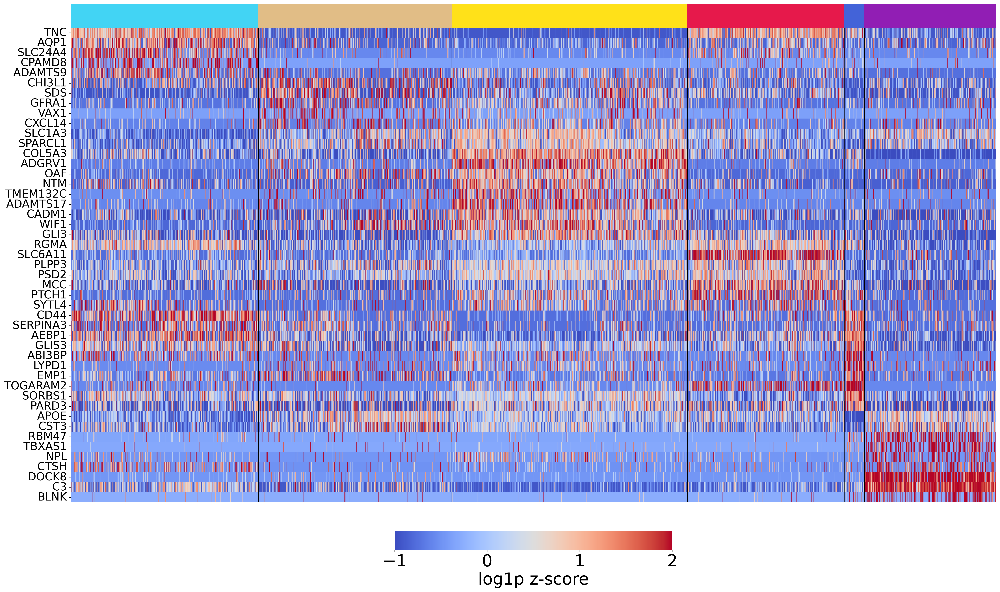

In [23]:
import matplotlib as mpl
import matplotlib.patches as patch
import matplotlib.pyplot as plt
import seaborn as sns
import os

mpl.rcParams['font.size'] = 30


file_name = 'Astrocyte_subtypes_DEG_heatmap'

fig,ax = plt.subplots(1,1, figsize = (30,15.5), dpi = 300)

# axis for color bar 
bbox = ax.get_position()
# ax_cbar = fig.add_axes([bbox.xmin + 1.05*bbox.width ,bbox.ymin + 0.3*bbox.height ,0.03*bbox.width,0.5*bbox.height])
ax_cbar = fig.add_axes([bbox.xmin + 0.35*bbox.width ,bbox.ymin - 0.1*bbox.height ,0.3*bbox.width,0.04*bbox.height])

     
sns.heatmap(
            markerGn_exp_zscore,
            xticklabels = False,
            yticklabels = top_markerGns,
            cmap = 'coolwarm',
            ax = ax,
            vmax = 2,
            vmin = -1,
            cbar_ax = ax_cbar,
            cbar_kws = {'label':'log1p z-score','orientation':'horizontal'}
            )

# cmap = ["#e6194B", "#3cb44b", "#ffe119", "#4363d8", "#f58231", "#911eb4", "#42d4f4", "#f032e6", "#bfef45",
#         "#fabed4", "#469990", "#dcbeff", "#9A6324", "#fffac8", "#800000", "#aaffc3", "#808000", "#ffd8b1",
#         "#000075", "#a9a9a9"]
# # add a lines and rectangular bars to indicate the cell types
cluster_names_ID_sorted = cluster_names_ID[cell_sortIDX]
end_pts = [np.where(cluster_names_ID_sorted == idx)[0].max() for idx in np.unique(cluster_names_ID_sorted) ]

for i,pt in enumerate(end_pts):
    ax.plot([pt,pt],[0,len(markerGn_exp_zscore)], lw = 1 , c = 'k')

bbox = ax.get_position()
ax1 = fig.add_axes([bbox.xmin,bbox.ymax,bbox.width,0.05*bbox.height])
# choices1 = cmap[:markerGn_exp_zscore.shape[-1]]

num_2_astrotypes = {num:clst for clst,num in astrotype_2_num.items()}
sorted_clusters = [num_2_astrotypes[ID] for ID in np.unique(cluster_names_ID[cell_sortIDX])]
choices1 = [cluster_cmap[clst] for clst in sorted_clusters]
my_colors = tuple(list(choices1)) #('C0', 'C1', 'C2')
cmap_d2 = mpl.colors.LinearSegmentedColormap.from_list('', my_colors, len(my_colors))
sns.heatmap(
            cluster_names_ID_sorted[np.newaxis,:],
            xticklabels = False,
            yticklabels = False,
            ax = ax1,
            cmap = cmap_d2,
            cbar = None,
            )


ax.yaxis.set_tick_params(labelsize=20)

plt.savefig(r'./figures/Custom_AstroCluster_Mainfigure_panels/Astrocyte_heatmap_mainFigure.png', bbox_inches = 'tight')
plt.savefig(r'./figures/Custom_AstroCluster_Mainfigure_panels/Astrocyte_heatmap_mainFigure.tif', bbox_inches = 'tight')
plt.show()

### 6. Plot a Matrix plot

In [24]:
unq_class = np.unique(cluster_names_ID[cell_sortIDX])
unq_class

array([0, 1, 2, 3, 4, 5])

In [25]:

markerGn_exp_zscore_avg = []
for class_idx in unq_class:
    keep = cluster_names_ID[cell_sortIDX] == class_idx
    markerGn_exp_zscore_avg += [np.mean(markerGn_exp_zscore[:,keep],axis=-1,keepdims = True)] # gns x 1
markerGn_exp_zscore_avg  = np.column_stack(markerGn_exp_zscore_avg)
markerGn_exp_zscore_avg.shape

(47, 6)

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


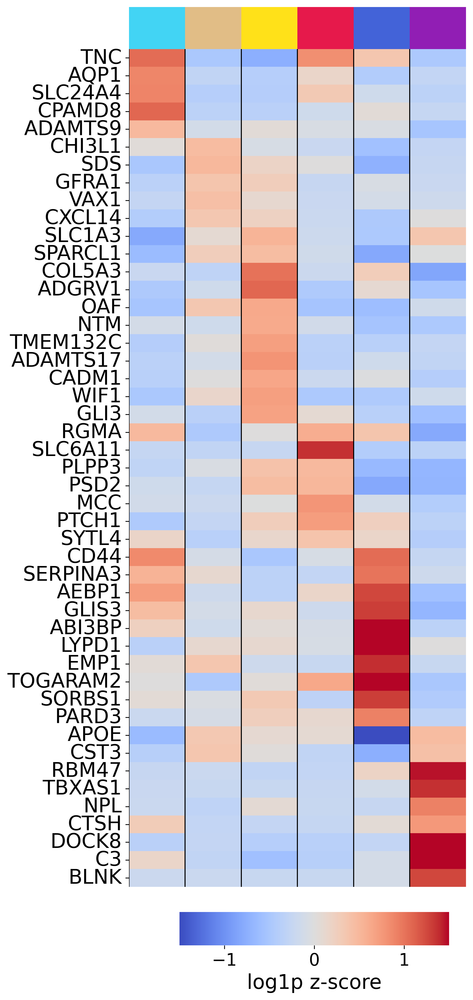

In [26]:
import matplotlib as mpl
import matplotlib.patches as patch
import matplotlib.pyplot as plt
import seaborn as sns
import os

mpl.rcParams['font.size'] = 17

plt.style.use('default')

file_name = 'Astrocyte_subtypes_DEG_matrixplot'

fig,ax = plt.subplots(1,1, figsize = (6,15), dpi = 300)

# axis for color bar 
# bbox = ax.get_position()
# ax_cbar = fig.add_axes([bbox.xmin + 1.05*bbox.width ,bbox.ymin + 0.3*bbox.height ,0.03*bbox.width,0.5*bbox.height])
bbox = ax.get_position()
ax_cbar = fig.add_axes([bbox.xmin + 0.15*bbox.width ,bbox.ymin - 0.07*bbox.height ,0.8*bbox.width,0.04*bbox.height])

    
sns.heatmap(
            markerGn_exp_zscore_avg,
            xticklabels = False,
            yticklabels = top_markerGns,
            cmap = 'coolwarm',
            ax = ax,
            vmax = 1.5,
            vmin = -1.5,
            cbar_ax = ax_cbar,
            cbar_kws = {'orientation':'horizontal'}
            )

# ax_cbar.set_xticks([-0.5,0,0.3], labels=[-0.5,0,0.3])
ax_cbar.set_xlabel('log1p z-score', fontdict={'fontsize': 20})
ax_cbar.tick_params('y',which='major',labelsize = 20)
ax_cbar.tick_params('x',which='major',labelsize = 17)


        
# cmap = ["#e6194B", "#3cb44b", "#ffe119", "#4363d8", "#f58231", "#911eb4", "#42d4f4", "#f032e6", "#bfef45",
#         "#fabed4", "#469990", "#dcbeff", "#9A6324", "#fffac8", "#800000", "#aaffc3", "#808000", "#ffd8b1",
#         "#000075", "#a9a9a9"]

# # # add a lines and rectangular bars to indicate the cell types
# Group_names_ID_sorted = Group_names_ID[cell_sortIDX]
# end_pts = [np.where(Group_names_ID_sorted == idx)[0].max() for idx in np.unique(Group_names_ID_sorted) ]

for i,pt in enumerate(unq_class):
    ax.plot([pt,pt],[0,len(markerGn_exp_zscore)], lw = 1 , c = 'k')

bbox = ax.get_position()
ax1 = fig.add_axes([bbox.xmin,bbox.ymax,bbox.width,0.05*bbox.height])
# choices1 = cmap[:markerGn_exp_zscore.shape[-1]]

num_2_astrotypes = {num:clst for clst,num in astrotype_2_num.items()}
sorted_clusters = [num_2_astrotypes[ID] for ID in np.unique(cluster_names_ID[cell_sortIDX])]
choices1 = [cluster_cmap[clst] for clst in sorted_clusters]
my_colors = tuple(list(choices1)) #('C0', 'C1', 'C2')
cmap_d2 = mpl.colors.LinearSegmentedColormap.from_list('', my_colors, len(my_colors))
sns.heatmap(
            unq_class[np.newaxis,:],
            xticklabels = False,
            yticklabels = False,
            ax = ax1,
            cmap = cmap_d2,
            cbar = None,
            )


ax.yaxis.set_tick_params(labelsize=20)

plt.savefig(r'./figures/Custom_AstroCluster_Mainfigure_panels/Astrocyte_Matrixplot_mainFigure_replotted.png', bbox_inches = 'tight')
plt.savefig(r'./figures/Custom_AstroCluster_Mainfigure_panels/Astrocyte_Matrixplot_mainFigure_replotted.tif', bbox_inches = 'tight')
plt.savefig(r'./figures/Custom_AstroCluster_Mainfigure_panels/Astrocyte_Matrixplot_mainFigure_replotted.eps', bbox_inches = 'tight')
plt.show()

#### 7. Spatial Map 

In [ ]:
# load in the contour for the spatial modules 
donor_1311_posterior_spatialModuleContours = np.load(r'/../../../spatialDomain_analysis/processed_data/donor_1311_PosteriorMERFISH/spatialModule_Contourcoord.npy',allow_pickle = True).item()
donor_1311_posterior_StriosomeContours = np.load(r'/../../../spatialDomain_analysis/processed_data/donor_1311_PosteriorMERFISH/Striosome_Contourcoord.npy',allow_pickle = True).item()

donor_2427_posterior_spatialModuleContours = np.load(r'/../../../spatialDomain_analysis/processed_data/donor_2724_PosteriorMERFISH/spatialModule_Contourcoord.npy',allow_pickle = True).item()
donor_2427_posterior_StriosomeContours = np.load(r'/../../../spatialDomain_analysis/processed_data/donor_2724_PosteriorMERFISH/Striosome_Contourcoord.npy',allow_pickle = True).item()

donor_2427_anterior_spatialModuleContours = np.load(r'/../../../spatialDomain_analysis/processed_data/chip5_AnteriorMERFISH/spatialModule_Contourcoord.npy',allow_pickle = True).item()
donor_2427_anterior_StriosomeContours = np.load(r'/../../../spatialDomain_analysis/processed_data/chip5_AnteriorMERFISH/Striosome_Contourcoord.npy',allow_pickle = True).item()

donor_3924_anterior_spatialModuleContours = np.load(r'/../../../spatialDomain_analysis/processed_data/donor_3924_AnteriorMERFISH/spatialModule_Contourcoord.npy',allow_pickle = True).item()
donor_3924_anterior_StriosomeContours = np.load(r'/../../../spatialDomain_analysis/processed_data/donor_3924_AnteriorMERFISH/Striosome_Contourcoord.npy',allow_pickle = True).item()

In [13]:
all_clusters = list(final_filtered_adata.obs['Astro_subtype'].cat.categories)
point_sz_map = {nm:2 for nm in final_filtered_adata.obs['Astro_subtype'].cat.categories}
point_sz_map

{'GP-TH_Astro': 2,
 'STR_Astro-1': 2,
 'STR_Astro-2': 2,
 'Vascular_Astro': 2,
 'ImAstro': 2,
 'WM_Astro': 2}

- Set the size of the Canvas 

In [14]:
import seaborn as sns
import matplotlib.patches as patches
import os
rot_deg = {'Donor_1311_posterior':0, 'Donor_2724_anterior':-45,'Donor_2724_posterior':0,'Donor_3924_anterior':45} # rotation value for each sample 

final_filtered_adata.obs[['x','y']] = final_filtered_adata.obsm['X_spatial'].copy()
figsize_scale = 8e3

dx_list = []
dy_list = []
samples = np.unique(final_filtered_adata.obs['samples'])
for i,sample in enumerate(samples):
    cond = final_filtered_adata.obs['samples'] == sample
    # adjucent the spatial coordinate 
    X_sample = final_filtered_adata[cond].obsm['X_spatial'].copy()
    X_sample = rotate(X_sample,rot_deg[sample]) # since rotation is could change the xy limit, perform rotation to get accurate estiamte

    # idenity the proprotion betwen the width and height of the sample
    dx,dy = np.abs(np.ptp(X_sample, axis = 0))
    dx_list += [dx/figsize_scale]
    dy_list += [dy/figsize_scale]
dx_max = np.max(dx_list)  
dy_max = np.max(dy_list)  
print(f'max-width:{dx_max}, max-height:{dy_max}')

max-width:3.4838343757507726, max-height:4.602077986449003


- 7.1 Combined spatial plots

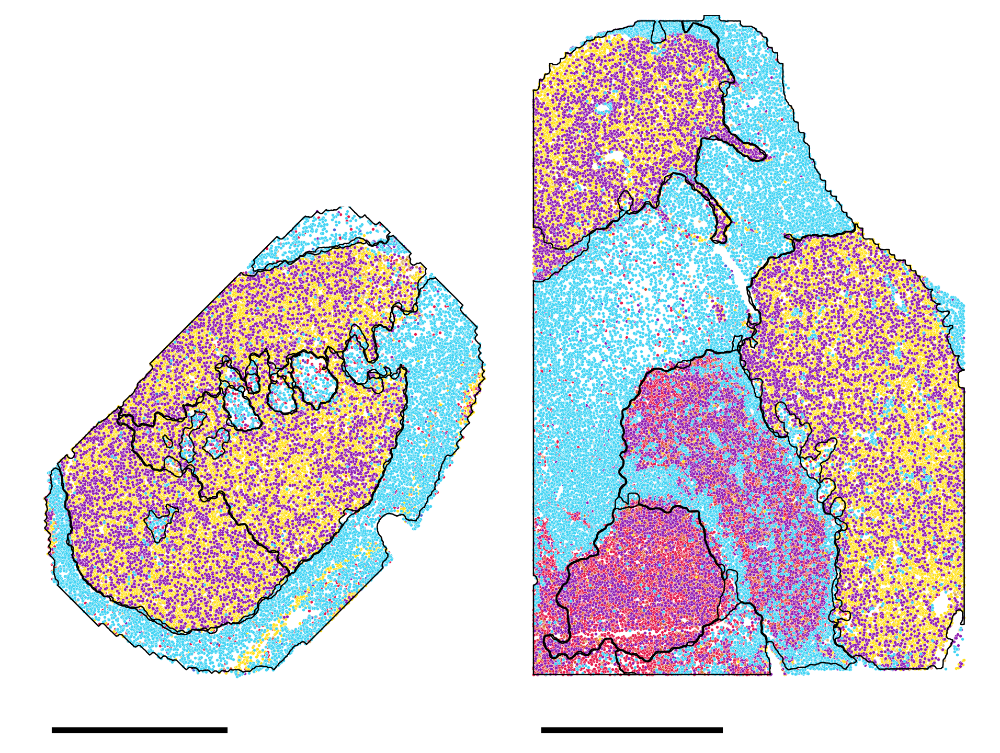

In [15]:
# define canvas for each samples, figure size will be based on the proprotion of the actual tissue size.

# fig,ax = plt.subplots(1,1,dpi = 300, figsize = (15,7))
import seaborn as sns
import matplotlib.patches as patches
import os
import copy 

rot_deg = {'Donor_1311_posterior':0, 'Donor_2724_anterior':-45,'Donor_2724_posterior':0,'Donor_3924_anterior':45} # rotation value for each sample 
reverse_coord = {'Donor_1311_posterior':False,'Donor_2724_anterior':True, 'Donor_2724_posterior':False,'Donor_3924_anterior':True }
invert_xaxis = {'Donor_1311_posterior':False,'Donor_2724_anterior':True,'Donor_2724_posterior':False,'Donor_3924_anterior':False }
invert_yaxis = {'Donor_1311_posterior':True,'Donor_2724_anterior':True,'Donor_2724_posterior':True,'Donor_3924_anterior':True}
backgd_sz = {'Donor_1311_posterior':0.002,'Donor_2724_anterior':0.002,'Donor_2724_posterior':0.002,'Donor_3924_anterior':0.002}
# spatial module dictionary
sptial_module_dict = {'Donor_1311_posterior':donor_1311_posterior_spatialModuleContours,'Donor_2724_anterior':donor_2427_anterior_spatialModuleContours,'Donor_2724_posterior':donor_2427_posterior_spatialModuleContours,'Donor_3924_anterior':donor_3924_anterior_spatialModuleContours}
Striosome_module_dict = {'Donor_1311_posterior':donor_1311_posterior_StriosomeContours,'Donor_2724_anterior':donor_2427_anterior_StriosomeContours,'Donor_2724_posterior':donor_2427_posterior_StriosomeContours,'Donor_3924_anterior':donor_3924_anterior_StriosomeContours}


fig = plt.figure(dpi = 300, figsize = (dx_max,dy_max))
bbox = fig.get_tightbbox()
ax = None

# samples = ['Donor_3924_anterior','Donor_2724_anterior','Donor_2724_posterior','Donor_1311_posterior']
samples = ['Donor_3924_anterior','Donor_1311_posterior']
figure_title = 'GPin_Cholin_posterior'
for sampleIdx,sample in enumerate(samples):
    cond = final_filtered_adata.obs['samples'] == sample
    # adjucent the spatial coordinate 
    X_sample = final_filtered_adata[cond].obsm['X_spatial'].copy()
    X_sample = rotate(X_sample,rot_deg[sample])
    cnt = copy.deepcopy(sptial_module_dict[sample])
    strio_cnt = Striosome_module_dict[sample]['Striosome'].copy()
    
    for label_ in cnt:
        if isinstance(cnt[label_],list):
            for i in range(len(cnt[label_])):
                cnt[label_][i] = rotate(cnt[label_][i],rot_deg[sample])
        else:   
            cnt[label_] = rotate(cnt[label_],rot_deg[sample])
    for idx in range(len(strio_cnt)):
        strio_cnt[idx] = rotate(strio_cnt[idx],rot_deg[sample])

    if reverse_coord[sample]:
        X_sample = X_sample[:,::-1]
        for label_ in cnt:
            if isinstance(cnt[label_],list):
                for i in range(len(cnt[label_])):
                    cnt[label_][i] = cnt[label_][i][:,::-1]
            else:
                cnt[label_] = cnt[label_][:,::-1]
        for idx in range(len(strio_cnt)):
            strio_cnt[idx] = strio_cnt[idx][:,::-1]

    final_filtered_adata.obs.loc[cond,['x','y']] = X_sample.copy()
    # idenity the proprotion betwen the width and height of the sample
    dx,dy = np.abs(np.ptp(X_sample, axis = 0))
    if ax != None:
        bbox = ax.get_position()
    dx = dx/figsize_scale
    dy = dy/figsize_scale
    # calculate fraction of the new x and y size as fraction of the previous axis x and y size. we are doing this because, fig.add_axes accept values as fraction of the figure width and hight, 
    dx_frac = dx/fig.get_figwidth()
    dy_frac = dy/fig.get_figheight()
    width_gap = 1
    # if sampleIdx < 2:
    #     width_gap = 0.8
    # #     point_sz_map[all_clusters_plot[0]] = 1
    # #     point_sz_map[all_clusters_plot[1]] = 1
    #     # point_sz_map[all_clusters_plot[2]] = 1
    # elif sampleIdx < 3:
    #     width_gap = 0.9

    ax = fig.add_axes([bbox.xmin + width_gap*bbox.width,bbox.ymin,dx_frac, dy_frac], adjustable = 'box')
    plot_cluster_scdata(final_filtered_adata[cond],cluster_cmap,all_clusters = all_clusters,clusters = all_clusters,bg_color = 'gray',bg_pt_size = backgd_sz[sample], point_sz_map = point_sz_map, transpose=1,flipx=1,flipy=1,hue_input = 'Astro_subtype' , ax = ax,use_seaborn = True,show_title = False )

    # add the outregion outlines 
    for label_ in ['Caudate','Putamen','NAC_shell','NAC_core','Gpi','Gpe','Internal_Capsule','BNST','anterior_commissure','Thalamus','whitematter(Olfactory area)','IsCj']:
        if label_ in cnt:
            if isinstance(cnt[label_],list):
                for i in range(len(cnt[label_])):
                    ax.plot(cnt[label_][i][:,0],cnt[label_][i][:,1], lw = 0.6, c = 'k')
            else:
                ax.plot(cnt[label_][:,0],cnt[label_][:,1], lw = 0.6, c = 'k')
    # add the striosome contour outline
    # for cnt in strio_cnt:
    #     ax.scatter(cnt[:,0],cnt[:,1], s = 0.01, c = 'k')      

    # Set the axis limits 
    xmax, ymax = X_sample.max(axis=0)
    xmin, ymin = X_sample.min(axis=0)
    # ax.set_xlim([xmin,xmax])
    ax.set_ylim([ymin,ymax + 3500])
    # add scale bar
    # add scale bar
    if sample == 'Donor_2724_anterior':
        scalebar = patches.Rectangle([xmax - 500,1*ymax + 3000],-10000,200,color = 'k')
    else:    
        scalebar = patches.Rectangle([xmin + 500,1*ymax + 3000],10000,200,color = 'k')
    
    ax.add_patch(scalebar)
    
    if invert_xaxis[sample]:
        ax.invert_xaxis()
    
    if invert_yaxis[sample]:
        ax.invert_yaxis()
    # ax.set_aspect('equal', adjustable ='datalim')
    # if sampleIdx == 0:
    #     ax.text(xmin + 0.7*np.ptp(X_sample[:,0]), ymin - 0.3*np.ptp(X_sample[:,1]), f'{cluster_}', fontsize = 25, color = 'k')
    #     ax.text(xmin + 0.2*np.ptp(X_sample[:,0]), ymin - 0.2*np.ptp(X_sample[:,1]), f'{figure_title}', fontsize = 25)

# file_name = '_'.join([x for x in f'{cluster_}'.replace(' ','_').split('-') ])
file_name = 'All_astrocytes_combined_spatialMaps'
plt.savefig(r'./figures/Custom_AstroCluster_Mainfigure_panels' + os.sep + file_name + '_updated.png',bbox_inches = 'tight')
plt.savefig(r'./figures/Custom_AstroCluster_Mainfigure_panels' + os.sep + file_name + '_updated.tif',bbox_inches = 'tight')
plt.savefig(r'./figures/Custom_AstroCluster_Mainfigure_panels' + os.sep + file_name + '_updated.eps',bbox_inches = 'tight')


plt.show()

- 7.2. Individual spatial plots

In [54]:
np.unique(final_filtered_adata.obs['Astro_subtype'])

array(['GP-TH_Astro', 'ImAstro', 'STR_Astro-1', 'STR_Astro-2',
       'Vascular_Astro', 'WM_Astro'], dtype=object)

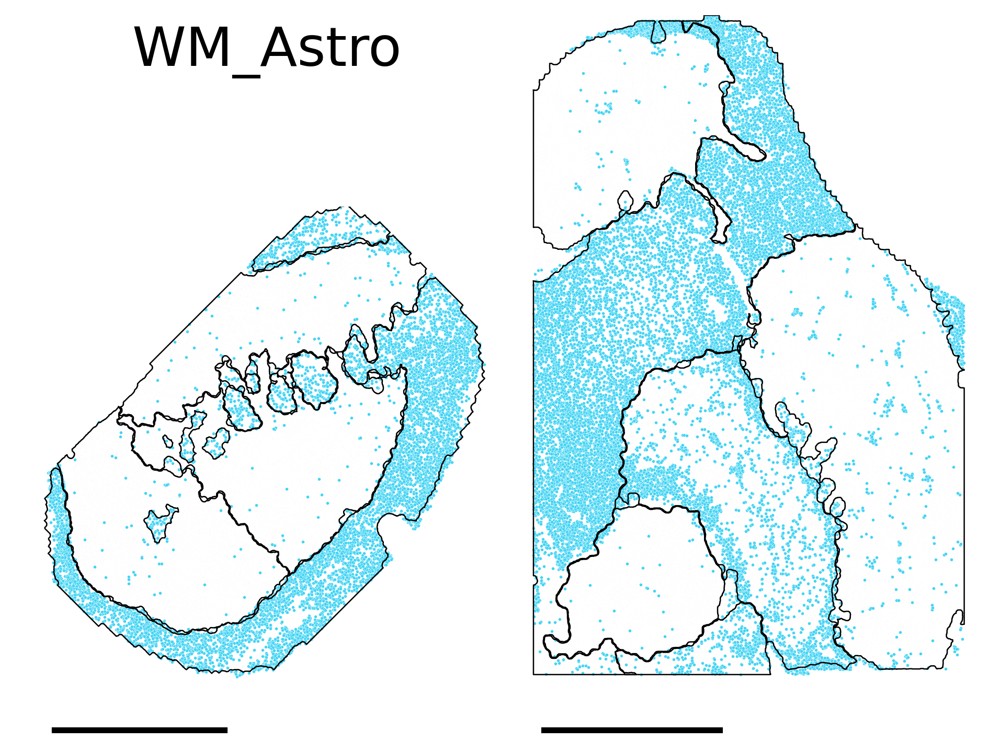

In [31]:
# define canvas for each samples, figure size will be based on the proprotion of the actual tissue size.

# fig,ax = plt.subplots(1,1,dpi = 300, figsize = (15,7))
import seaborn as sns
import matplotlib.patches as patches
import os
import copy 

rot_deg = {'Donor_1311_posterior':0, 'Donor_2724_anterior':-45,'Donor_2724_posterior':0,'Donor_3924_anterior':45} # rotation value for each sample 
reverse_coord = {'Donor_1311_posterior':False,'Donor_2724_anterior':True, 'Donor_2724_posterior':False,'Donor_3924_anterior':True }
invert_xaxis = {'Donor_1311_posterior':False,'Donor_2724_anterior':True,'Donor_2724_posterior':False,'Donor_3924_anterior':False }
invert_yaxis = {'Donor_1311_posterior':True,'Donor_2724_anterior':True,'Donor_2724_posterior':True,'Donor_3924_anterior':True}
backgd_sz = {'Donor_1311_posterior':0.002,'Donor_2724_anterior':0.002,'Donor_2724_posterior':0.002,'Donor_3924_anterior':0.002}
# spatial module dictionary
sptial_module_dict = {'Donor_1311_posterior':donor_1311_posterior_spatialModuleContours,'Donor_2724_anterior':donor_2427_anterior_spatialModuleContours,'Donor_2724_posterior':donor_2427_posterior_spatialModuleContours,'Donor_3924_anterior':donor_3924_anterior_spatialModuleContours}
Striosome_module_dict = {'Donor_1311_posterior':donor_1311_posterior_StriosomeContours,'Donor_2724_anterior':donor_2427_anterior_StriosomeContours,'Donor_2724_posterior':donor_2427_posterior_StriosomeContours,'Donor_3924_anterior':donor_3924_anterior_StriosomeContours}

# all_clusters_plot = ['GPe-NDB-SI LHX6-LHX8-GBX1 GABA', 'SN-VTR-HTH GATA3-TCF7L2 GABA','STR FS PTHLH-PVALB GABA', 'STR-BF TAC3-PLPP4-LHX8 GABA','STRd D2 StrioMat Hybrid MSN']
# all_clusters_plot = [ 'STRd D2 Striosome MSN','STRd D2 Matrix MSN','STRv D2 MSN']
# all_clusters_plot = ['GP-TH_Astro']
all_clusters_plot = ['WM_Astro']
for cluster_ in all_clusters_plot:

    fig = plt.figure(dpi = 300, figsize = (dx_max,dy_max))
    bbox = fig.get_tightbbox()
    ax = None

    # samples = ['Donor_3924_anterior','Donor_2724_anterior','Donor_2724_posterior','Donor_1311_posterior']
    samples = ['Donor_3924_anterior','Donor_1311_posterior']
    figure_title = 'GPin_Cholin_posterior'
    for sampleIdx,sample in enumerate(samples):
        cond = final_filtered_adata.obs['samples'] == sample
        # adjucent the spatial coordinate 
        X_sample = final_filtered_adata[cond].obsm['X_spatial'].copy()
        X_sample = rotate(X_sample,rot_deg[sample])
        cnt = copy.deepcopy(sptial_module_dict[sample])
        strio_cnt = Striosome_module_dict[sample]['Striosome'].copy()
        
        for label_ in cnt:
            if isinstance(cnt[label_],list):
                for i in range(len(cnt[label_])):
                    cnt[label_][i] = rotate(cnt[label_][i],rot_deg[sample])
            else:   
                cnt[label_] = rotate(cnt[label_],rot_deg[sample])
        for idx in range(len(strio_cnt)):
            strio_cnt[idx] = rotate(strio_cnt[idx],rot_deg[sample])

        if reverse_coord[sample]:
            X_sample = X_sample[:,::-1]
            for label_ in cnt:
                if isinstance(cnt[label_],list):
                    for i in range(len(cnt[label_])):
                        cnt[label_][i] = cnt[label_][i][:,::-1]
                else:
                    cnt[label_] = cnt[label_][:,::-1]
            for idx in range(len(strio_cnt)):
                strio_cnt[idx] = strio_cnt[idx][:,::-1]

        final_filtered_adata.obs.loc[cond,['x','y']] = X_sample.copy()
        # idenity the proprotion betwen the width and height of the sample
        dx,dy = np.abs(np.ptp(X_sample, axis = 0))
        if ax != None:
            bbox = ax.get_position()
        dx = dx/figsize_scale
        dy = dy/figsize_scale
        # calculate fraction of the new x and y size as fraction of the previous axis x and y size. we are doing this because, fig.add_axes accept values as fraction of the figure width and hight, 
        dx_frac = dx/fig.get_figwidth()
        dy_frac = dy/fig.get_figheight()
        width_gap = 1
        # if sampleIdx < 2:
        #     width_gap = 0.8
        # #     point_sz_map[all_clusters_plot[0]] = 1
        # #     point_sz_map[all_clusters_plot[1]] = 1
        #     # point_sz_map[all_clusters_plot[2]] = 1
        # elif sampleIdx < 3:
        #     width_gap = 0.9

        ax = fig.add_axes([bbox.xmin + width_gap*bbox.width,bbox.ymin,dx_frac, dy_frac], adjustable = 'box')
        plot_cluster_scdata(final_filtered_adata[cond],cluster_cmap,all_clusters = [cluster_],clusters = [cluster_],bg_color = 'gray',bg_pt_size = backgd_sz[sample], point_sz_map = point_sz_map, transpose=1,flipx=1,flipy=1,hue_input = 'Astro_subtype' , ax = ax,use_seaborn = True,show_title = False )

        # add the outregion outlines 
        for label_ in ['Caudate','Putamen','NAC_shell','NAC_core','Gpi','Gpe','Internal_Capsule','BNST','anterior_commissure','Thalamus','whitematter(Olfactory area)','IsCj']:
            if label_ in cnt:
                if isinstance(cnt[label_],list):
                    for i in range(len(cnt[label_])):
                        ax.plot(cnt[label_][i][:,0],cnt[label_][i][:,1], lw = 0.6, c = 'k')
                else:
                    ax.plot(cnt[label_][:,0],cnt[label_][:,1], lw = 0.6, c = 'k')
        # add the striosome contour outline
        # for cnt in strio_cnt:
        #     ax.scatter(cnt[:,0],cnt[:,1], s = 0.01, c = 'k')      

        # Set the axis limits 
        xmax, ymax = X_sample.max(axis=0)
        xmin, ymin = X_sample.min(axis=0)
        # ax.set_xlim([xmin,xmax])
        ax.set_ylim([ymin,ymax + 3500])
        # add scale bar
        # add scale bar
        if sample == 'Donor_2724_anterior':
            scalebar = patches.Rectangle([xmax - 500,1*ymax + 3000],-10000,200,color = 'k')
        else:    
            scalebar = patches.Rectangle([xmin + 500,1*ymax + 3000],10000,200,color = 'k')
        
        ax.add_patch(scalebar)
        
        if invert_xaxis[sample]:
            ax.invert_xaxis()
        
        if invert_yaxis[sample]:
            ax.invert_yaxis()
        # ax.set_aspect('equal', adjustable ='datalim')
        if sampleIdx == 0:
            # ax.text(xmin + 0.7*np.ptp(X_sample[:,0]), ymin - 0.3*np.ptp(X_sample[:,1]), f'{cluster_}', fontsize = 25, color = 'k')
            ax.text(xmin + 0.2*np.ptp(X_sample[:,0]), ymin - 0.3*np.ptp(X_sample[:,1]), f'{cluster_}', fontsize = 25, color = 'k')
            # ax.text(xmin + 0.2*np.ptp(X_sample[:,0]), ymin - 0.2*np.ptp(X_sample[:,1]), f'{figure_title}', fontsize = 25)

    file_name = '_'.join([x for x in f'{cluster_}'.replace(' ','_').split('-') ])
    plt.savefig(r'./figures/Custom_AstroCluster_Mainfigure_panels' + os.sep + file_name + '.png',bbox_inches = 'tight')
    plt.savefig(r'./figures/Custom_AstroCluster_Mainfigure_panels' + os.sep + file_name + '.tif',bbox_inches = 'tight')

    plt.show()

- 7.3. Spatial plot of the heatmap

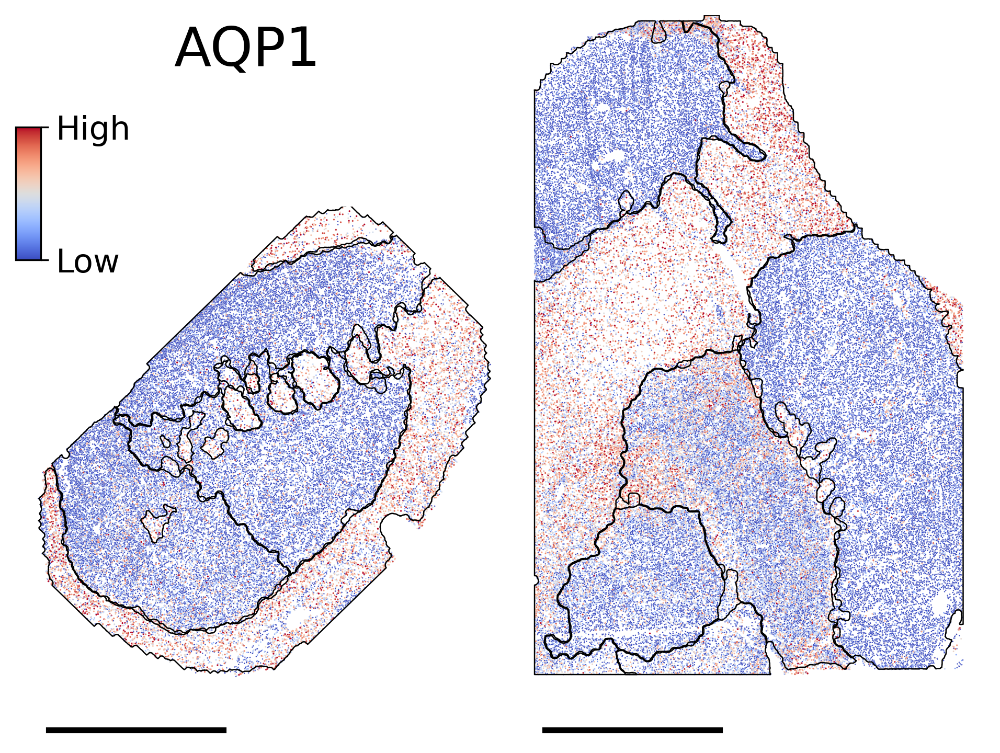

In [34]:
# define canvas for each samples, figure size will be based on the proprotion of the actual tissue size.

# fig,ax = plt.subplots(1,1,dpi = 300, figsize = (15,7))
import seaborn as sns
import matplotlib.patches as patches
import os
import copy 

rot_deg = {'Donor_1311_posterior':0, 'Donor_2724_anterior':-45,'Donor_2724_posterior':0,'Donor_3924_anterior':45} # rotation value for each sample 
reverse_coord = {'Donor_1311_posterior':False,'Donor_2724_anterior':True, 'Donor_2724_posterior':False,'Donor_3924_anterior':True }
invert_xaxis = {'Donor_1311_posterior':False,'Donor_2724_anterior':True,'Donor_2724_posterior':False,'Donor_3924_anterior':False }
invert_yaxis = {'Donor_1311_posterior':True,'Donor_2724_anterior':True,'Donor_2724_posterior':True,'Donor_3924_anterior':True}
backgd_sz = {'Donor_1311_posterior':0.002,'Donor_2724_anterior':0.002,'Donor_2724_posterior':0.002,'Donor_3924_anterior':0.002}
# spatial module dictionary
sptial_module_dict = {'Donor_1311_posterior':donor_1311_posterior_spatialModuleContours,'Donor_2724_anterior':donor_2427_anterior_spatialModuleContours,'Donor_2724_posterior':donor_2427_posterior_spatialModuleContours,'Donor_3924_anterior':donor_3924_anterior_spatialModuleContours}
Striosome_module_dict = {'Donor_1311_posterior':donor_1311_posterior_StriosomeContours,'Donor_2724_anterior':donor_2427_anterior_StriosomeContours,'Donor_2724_posterior':donor_2427_posterior_StriosomeContours,'Donor_3924_anterior':donor_3924_anterior_StriosomeContours}

# all_clusters_plot = ['GPe-NDB-SI LHX6-LHX8-GBX1 GABA', 'SN-VTR-HTH GATA3-TCF7L2 GABA','STR FS PTHLH-PVALB GABA', 'STR-BF TAC3-PLPP4-LHX8 GABA','STRd D2 StrioMat Hybrid MSN']
# all_clusters_plot = [ 'STRd D2 Striosome MSN','STRd D2 Matrix MSN','STRv D2 MSN']
genes_toPlot = ['AQP1']
for gn in genes_toPlot:

    fig = plt.figure(dpi = 300, figsize = (dx_max,dy_max))
    bbox = fig.get_tightbbox()
    ax = None

    # samples = ['Donor_3924_anterior','Donor_2724_anterior','Donor_2724_posterior','Donor_1311_posterior']
    samples = ['Donor_3924_anterior','Donor_1311_posterior']
    for sampleIdx,sample in enumerate(samples):
        cond = final_filtered_adata.obs['samples'] == sample
        # adjucent the spatial coordinate 
        X_sample = final_filtered_adata[cond].obsm['X_spatial'].copy()
        X_sample = rotate(X_sample,rot_deg[sample])
        cnt = copy.deepcopy(sptial_module_dict[sample])
        strio_cnt = Striosome_module_dict[sample]['Striosome'].copy()
        
        for label_ in cnt:
            if isinstance(cnt[label_],list):
                for i in range(len(cnt[label_])):
                    cnt[label_][i] = rotate(cnt[label_][i],rot_deg[sample])
            else:   
                cnt[label_] = rotate(cnt[label_],rot_deg[sample])
        for idx in range(len(strio_cnt)):
            strio_cnt[idx] = rotate(strio_cnt[idx],rot_deg[sample])

        if reverse_coord[sample]:
            X_sample = X_sample[:,::-1]
            for label_ in cnt:
                if isinstance(cnt[label_],list):
                    for i in range(len(cnt[label_])):
                        cnt[label_][i] = cnt[label_][i][:,::-1]
                else:
                    cnt[label_] = cnt[label_][:,::-1]
            for idx in range(len(strio_cnt)):
                strio_cnt[idx] = strio_cnt[idx][:,::-1]

        final_filtered_adata.obs.loc[cond,['x','y']] = X_sample.copy()
        # idenity the proprotion betwen the width and height of the sample
        dx,dy = np.abs(np.ptp(X_sample, axis = 0))
        if ax != None:
            bbox = ax.get_position()
        dx = dx/figsize_scale
        dy = dy/figsize_scale
        # calculate fraction of the new x and y size as fraction of the previous axis x and y size. we are doing this because, fig.add_axes accept values as fraction of the figure width and hight, 
        dx_frac = dx/fig.get_figwidth()
        dy_frac = dy/fig.get_figheight()
        width_gap = 1
        # if sampleIdx < 2:
        #     width_gap = 0.8
        # #     point_sz_map[all_clusters_plot[0]] = 1
        # #     point_sz_map[all_clusters_plot[1]] = 1
        #     # point_sz_map[all_clusters_plot[2]] = 1
        # elif sampleIdx < 3:
        #     width_gap = 0.9

        ax = fig.add_axes([bbox.xmin + width_gap*bbox.width,bbox.ymin,dx_frac, dy_frac], adjustable = 'box')
        # Plot the gene expression spatial map

        exp = final_filtered_adata[cond][:,gn].layers['log_count']
        M = np.percentile(exp,99)
        m = np.percentile(exp,1)
        expN = (exp - m)/(M-m)
        expN_ = np.clip(expN,0,1)
        szmax = 0.7
        szmin = 0.4
        sz = szmin + expN_*(szmax - szmin)
        cmap = mpl.cm.coolwarm(expN_)
        sns.scatterplot(x = X_sample[:,0], y = X_sample[:,1], s = sz.ravel(), c = cmap, ax = ax) # expression map of gene
        ax.set_axis_off()
        # plot_cluster_scdata(final_filtered_adata[cond],cluster_cmap,all_clusters = [cluster_],clusters = [cluster_],bg_color = 'gray',bg_pt_size = backgd_sz[sample], point_sz_map = point_sz_map, transpose=1,flipx=1,flipy=1,hue_input = 'Cluster_name' , ax = ax,use_seaborn = True,show_title = False )

        # add the outregion outlines 
        for label_ in ['Caudate','Putamen','NAC_shell','NAC_core','Gpi','Gpe','Internal_Capsule','BNST','anterior_commissure','Thalamus','whitematter(Olfactory area)','IsCj']:
            if label_ in cnt:
                if isinstance(cnt[label_],list):
                    for i in range(len(cnt[label_])):
                        ax.plot(cnt[label_][i][:,0],cnt[label_][i][:,1], lw = 0.6, c = 'k')
                else:
                    ax.plot(cnt[label_][:,0],cnt[label_][:,1], lw = 0.6, c = 'k')
        # add the striosome contour outline
        # for cnt in strio_cnt:
        #     ax.scatter(cnt[:,0],cnt[:,1], s = 0.01, c = 'k')      

        # Set the axis limits 
        xmax, ymax = X_sample.max(axis=0)
        xmin, ymin = X_sample.min(axis=0)
        # ax.set_xlim([xmin,xmax])
        ax.set_ylim([ymin,ymax + 3500])
        # add scale bar
        # add scale bar
        if sample == 'Donor_2724_anterior':
            scalebar = patches.Rectangle([xmax - 500,1*ymax + 3000],-10000,200,color = 'k')
        else:    
            scalebar = patches.Rectangle([xmin + 500,1*ymax + 3000],10000,200,color = 'k')
        
        ax.add_patch(scalebar)
        
        if invert_xaxis[sample]:
            ax.invert_xaxis()
        
        if invert_yaxis[sample]:
            ax.invert_yaxis()
        # ax.set_aspect('equal', adjustable ='datalim')
        if sampleIdx == 0:
            # ax.text(xmin + 0.7*np.ptp(X_sample[:,0]), ymin - 0.3*np.ptp(X_sample[:,1]), f'{gn}', fontsize = 25, color = 'k')
            ax.text(xmin + 0.3*np.ptp(X_sample[:,0]), ymin - 0.3*np.ptp(X_sample[:,1]), f'{gn}', fontsize = 25, color = 'k')
            # add axes for the colorbar 
            bbox = ax.get_position()
            ax_cbar = fig.add_axes([bbox.xmin, bbox.ymin + 0.9*bbox.height, 0.05*bbox.width,0.25*bbox.height])
            norm = mpl.colors.Normalize(vmin=0, vmax=1)
            fig.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap='coolwarm'), cax=ax_cbar,)
            ax_cbar.set_yticks([1,0],labels = ['High','Low'],fontsize = 15)

    file_name = '_'.join([x for x in f'{gn}'.replace(' ','_').split('-') ])
    plt.savefig(r'./figures/Custom_AstroCluster_Mainfigure_panels' + os.sep + file_name + '_spatialMap.png',bbox_inches = 'tight')
    plt.savefig(r'./figures/Custom_AstroCluster_Mainfigure_panels' + os.sep + file_name + '_spatialMap.tif',bbox_inches = 'tight')

    plt.show()

### Supplemental Figures

In [50]:
import numpy as np
import seaborn as sns 
import matplotlib.pyplot as plt
import anndata
import pandas as pd
import scanpy as sc
import rapids_singlecell as rsc

In [ ]:
final_filtered_adata = anndata.read_h5ad(r'./final_filtered_adata_customCluster.h5ad')
final_filtered_adata

AnnData object with n_obs × n_vars = 289805 × 123
    obs: 'volm', 'leiden', 'Neighborhood_label', 'Neighborhood_name', 'Neighborhood_bootstrapping_probability', 'Class_label', 'Class_name', 'Class_bootstrapping_probability', 'Subclass_label', 'Subclass_name', 'Subclass_bootstrapping_probability', 'Group_label', 'Group_name', 'Group_bootstrapping_probability', 'Cluster_label', 'Cluster_name', 'Cluster_alias', 'Cluster_bootstrapping_probability', 'Final_Major_region_label', 'MatrixStriosome_label', 'samples', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'x', 'y', 'Astro_subtype'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mean', 'std'
    uns: 'Astro_subtype_colors', 'Astro_subtype_sizes', 'Cluster_name_colors', 'leiden', 'leiden_colors', 'l

In [52]:
np.unique(final_filtered_adata.obs['Astro_subtype'])

array(['GP-TH_Astro', 'ImAstro', 'STR_Astro-1', 'STR_Astro-2',
       'Vascular_Astro', 'WM_Astro'], dtype=object)

In [53]:
cluster_cmap = {nm:clr for clr,nm in zip(final_filtered_adata.uns['Astro_subtype_colors'],final_filtered_adata.obs['Astro_subtype'].cat.categories)}
cluster_cmap

{'GP-TH_Astro': '#e6194b',
 'STR_Astro-1': '#c276057b',
 'STR_Astro-2': '#ffe119',
 'Vascular_Astro': '#4363d8',
 'ImAstro': '#911eb4',
 'WM_Astro': '#42d4f4'}

In [54]:
point_sz_map = {nm:2 for nm in final_filtered_adata.obs['Astro_subtype'].cat.categories}
point_sz_map

{'GP-TH_Astro': 2,
 'STR_Astro-1': 2,
 'STR_Astro-2': 2,
 'Vascular_Astro': 2,
 'ImAstro': 2,
 'WM_Astro': 2}

In [ ]:
# load in the contour for the spatial modules 
donor_1311_posterior_spatialModuleContours = np.load(r'/../../..//spatialDomain_analysis/processed_data/donor_1311_PosteriorMERFISH/spatialModule_Contourcoord.npy',allow_pickle = True).item()
donor_1311_posterior_StriosomeContours = np.load(r'/../../..//spatialDomain_analysis/processed_data/donor_1311_PosteriorMERFISH/Striosome_Contourcoord.npy',allow_pickle = True).item()

donor_2427_posterior_spatialModuleContours = np.load(r'/../../..//spatialDomain_analysis/processed_data/donor_2724_PosteriorMERFISH/spatialModule_Contourcoord.npy',allow_pickle = True).item()
donor_2427_posterior_StriosomeContours = np.load(r'/../../..//spatialDomain_analysis/processed_data/donor_2724_PosteriorMERFISH/Striosome_Contourcoord.npy',allow_pickle = True).item()

donor_2427_anterior_spatialModuleContours = np.load(r'/../../..//spatialDomain_analysis/processed_data/chip5_AnteriorMERFISH/spatialModule_Contourcoord.npy',allow_pickle = True).item()
donor_2427_anterior_StriosomeContours = np.load(r'/../../..//spatialDomain_analysis/processed_data/chip5_AnteriorMERFISH/Striosome_Contourcoord.npy',allow_pickle = True).item()

donor_3924_anterior_spatialModuleContours = np.load(r'/../../..//spatialDomain_analysis/processed_data/donor_3924_AnteriorMERFISH/spatialModule_Contourcoord.npy',allow_pickle = True).item()
donor_3924_anterior_StriosomeContours = np.load(r'/../../..//spatialDomain_analysis/processed_data/donor_3924_AnteriorMERFISH/Striosome_Contourcoord.npy',allow_pickle = True).item()

In [56]:
import seaborn as sns
import matplotlib.patches as patches
import os
rot_deg = {'Donor_1311_posterior':0, 'Donor_2724_anterior':-45,'Donor_2724_posterior':0,'Donor_3924_anterior':45} # rotation value for each sample 

final_filtered_adata.obs[['x','y']] = final_filtered_adata.obsm['X_spatial'].copy()
figsize_scale = 8e3

dx_list = []
dy_list = []
samples = np.unique(final_filtered_adata.obs['samples'])
for i,sample in enumerate(samples):
    cond = final_filtered_adata.obs['samples'] == sample
    # adjucent the spatial coordinate 
    X_sample = final_filtered_adata[cond].obsm['X_spatial'].copy()
    X_sample = rotate(X_sample,rot_deg[sample]) # since rotation is could change the xy limit, perform rotation to get accurate estiamte

    # idenity the proprotion betwen the width and height of the sample
    dx,dy = np.abs(np.ptp(X_sample, axis = 0))
    dx_list += [dx/figsize_scale]
    dy_list += [dy/figsize_scale]
dx_max = np.max(dx_list)  
dy_max = np.max(dy_list)  
print(f'max-width:{dx_max}, max-height:{dy_max}')

max-width:3.4838343757507726, max-height:4.602077986449003


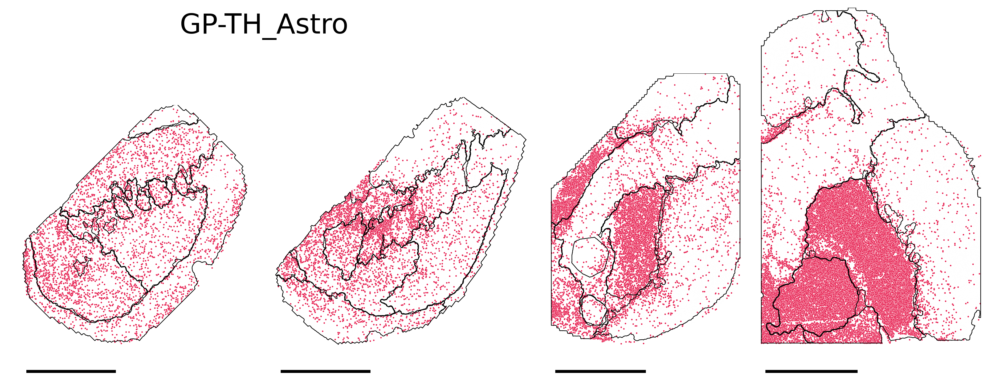

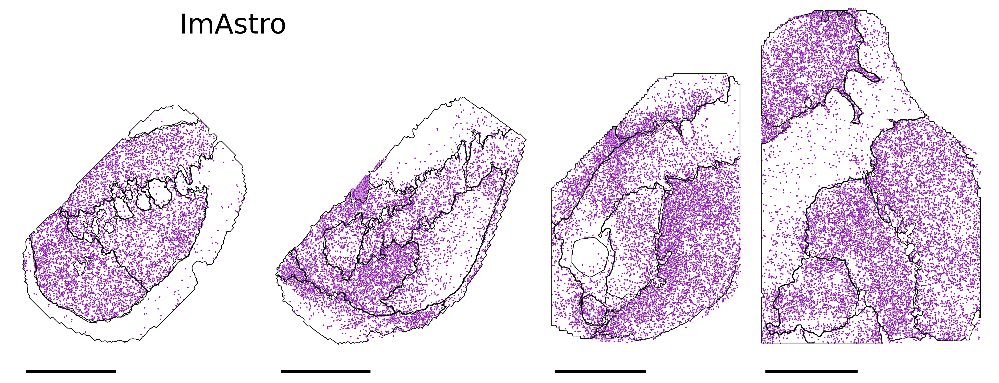

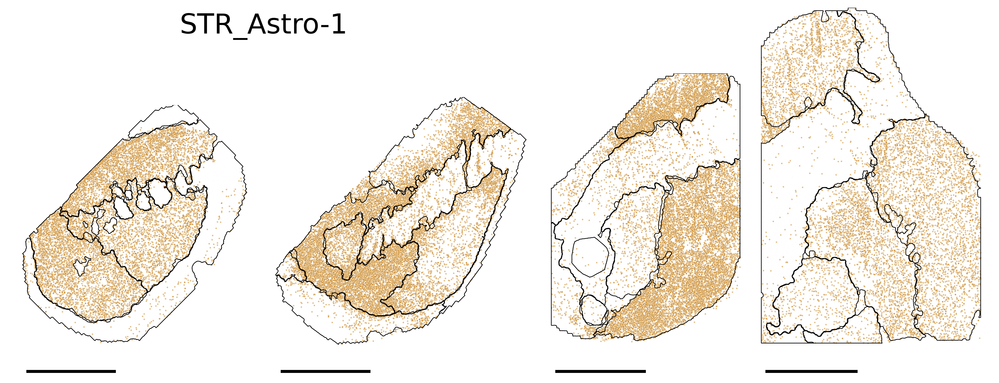

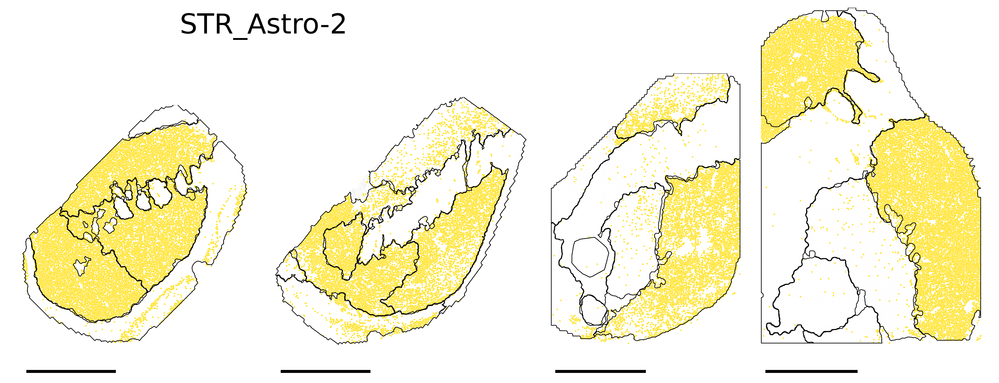

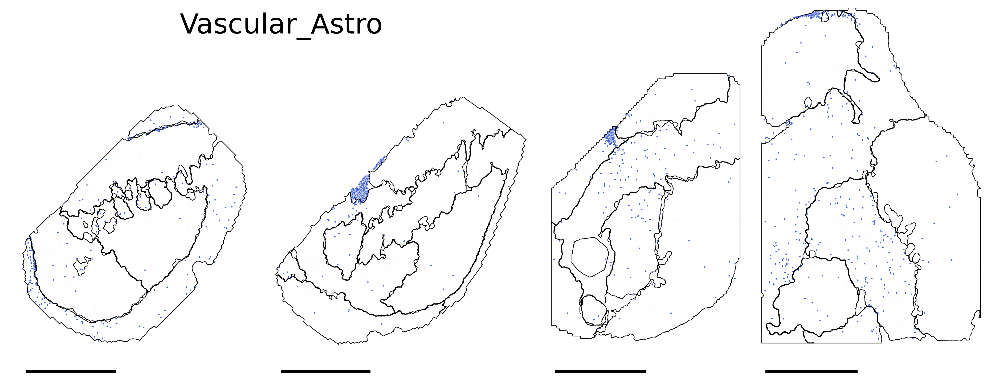

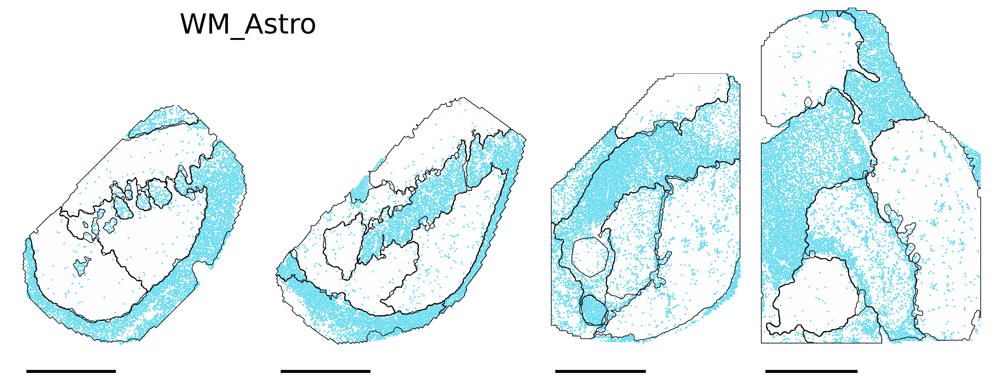

In [24]:
# define canvas for each samples, figure size will be based on the proprotion of the actual tissue size.

# fig,ax = plt.subplots(1,1,dpi = 300, figsize = (15,7))
import seaborn as sns
import matplotlib.patches as patches
import os
import copy 

rot_deg = {'Donor_1311_posterior':0, 'Donor_2724_anterior':-45,'Donor_2724_posterior':0,'Donor_3924_anterior':45} # rotation value for each sample 
reverse_coord = {'Donor_1311_posterior':False,'Donor_2724_anterior':True, 'Donor_2724_posterior':False,'Donor_3924_anterior':True }
invert_xaxis = {'Donor_1311_posterior':False,'Donor_2724_anterior':True,'Donor_2724_posterior':False,'Donor_3924_anterior':False }
invert_yaxis = {'Donor_1311_posterior':True,'Donor_2724_anterior':True,'Donor_2724_posterior':True,'Donor_3924_anterior':True}
backgd_sz = {'Donor_1311_posterior':0.002,'Donor_2724_anterior':0.002,'Donor_2724_posterior':0.002,'Donor_3924_anterior':0.002}
# spatial module dictionary
sptial_module_dict = {'Donor_1311_posterior':donor_1311_posterior_spatialModuleContours,'Donor_2724_anterior':donor_2427_anterior_spatialModuleContours,'Donor_2724_posterior':donor_2427_posterior_spatialModuleContours,'Donor_3924_anterior':donor_3924_anterior_spatialModuleContours}
Striosome_module_dict = {'Donor_1311_posterior':donor_1311_posterior_StriosomeContours,'Donor_2724_anterior':donor_2427_anterior_StriosomeContours,'Donor_2724_posterior':donor_2427_posterior_StriosomeContours,'Donor_3924_anterior':donor_3924_anterior_StriosomeContours}

# all_clusters_plot = ['GPe-NDB-SI LHX6-LHX8-GBX1 GABA', 'SN-VTR-HTH GATA3-TCF7L2 GABA','STR FS PTHLH-PVALB GABA', 'STR-BF TAC3-PLPP4-LHX8 GABA','STRd D2 StrioMat Hybrid MSN']
# all_clusters_plot = [ 'STRd D2 Striosome MSN','STRd D2 Matrix MSN','STRv D2 MSN']
all_clusters_plot = ['GP-TH_Astro', 'ImAstro', 'STR_Astro-1', 'STR_Astro-2',
       'Vascular_Astro', 'WM_Astro']
for cluster_ in all_clusters_plot:

    fig = plt.figure(dpi = 300, figsize = (dx_max,dy_max))
    bbox = fig.get_tightbbox()
    ax = None

    samples = ['Donor_3924_anterior','Donor_2724_anterior','Donor_2724_posterior','Donor_1311_posterior']
    # samples = ['Donor_2724_posterior','Donor_1311_posterior']
    figure_title = 'GPin_Cholin_posterior'
    for sampleIdx,sample in enumerate(samples):
        cond = final_filtered_adata.obs['samples'] == sample
        # adjucent the spatial coordinate 
        X_sample = final_filtered_adata[cond].obsm['X_spatial'].copy()
        X_sample = rotate(X_sample,rot_deg[sample])
        cnt = copy.deepcopy(sptial_module_dict[sample])
        strio_cnt = Striosome_module_dict[sample]['Striosome'].copy()
        
        for label_ in cnt:
            if isinstance(cnt[label_],list):
                for i in range(len(cnt[label_])):
                    cnt[label_][i] = rotate(cnt[label_][i],rot_deg[sample])
            else:   
                cnt[label_] = rotate(cnt[label_],rot_deg[sample])
        for idx in range(len(strio_cnt)):
            strio_cnt[idx] = rotate(strio_cnt[idx],rot_deg[sample])

        if reverse_coord[sample]:
            X_sample = X_sample[:,::-1]
            for label_ in cnt:
                if isinstance(cnt[label_],list):
                    for i in range(len(cnt[label_])):
                        cnt[label_][i] = cnt[label_][i][:,::-1]
                else:
                    cnt[label_] = cnt[label_][:,::-1]
            for idx in range(len(strio_cnt)):
                strio_cnt[idx] = strio_cnt[idx][:,::-1]

        final_filtered_adata.obs.loc[cond,['x','y']] = X_sample.copy()
        # idenity the proprotion betwen the width and height of the sample
        dx,dy = np.abs(np.ptp(X_sample, axis = 0))
        if ax != None:
            bbox = ax.get_position()
        dx = dx/figsize_scale
        dy = dy/figsize_scale
        # calculate fraction of the new x and y size as fraction of the previous axis x and y size. we are doing this because, fig.add_axes accept values as fraction of the figure width and hight, 
        dx_frac = dx/fig.get_figwidth()
        dy_frac = dy/fig.get_figheight()
        width_gap = 1
        # if sampleIdx < 2:
        #     width_gap = 0.8
        # #     point_sz_map[all_clusters_plot[0]] = 1
        # #     point_sz_map[all_clusters_plot[1]] = 1
        #     # point_sz_map[all_clusters_plot[2]] = 1
        # elif sampleIdx < 3:
        #     width_gap = 0.9

        ax = fig.add_axes([bbox.xmin + width_gap*bbox.width,bbox.ymin,dx_frac, dy_frac], adjustable = 'box')
        plot_cluster_scdata(final_filtered_adata[cond],cluster_cmap,all_clusters = [cluster_],clusters = [cluster_],bg_color = 'gray',bg_pt_size = backgd_sz[sample], point_sz_map = point_sz_map, transpose=1,flipx=1,flipy=1,hue_input = 'Astro_subtype' , ax = ax,use_seaborn = True,show_title = False )

        # add the outregion outlines 
        for label_ in ['Caudate','Putamen','NAC_shell','NAC_core','Gpi','Gpe','Internal_Capsule','BNST','anterior_commissure','Thalamus','whitematter(Olfactory area)','IsCj']:
            if label_ in cnt:
                if isinstance(cnt[label_],list):
                    for i in range(len(cnt[label_])):
                        ax.plot(cnt[label_][i][:,0],cnt[label_][i][:,1], lw = 0.6, c = 'k')
                else:
                    ax.plot(cnt[label_][:,0],cnt[label_][:,1], lw = 0.6, c = 'k')
        # add the striosome contour outline
        # for cnt in strio_cnt:
        #     ax.scatter(cnt[:,0],cnt[:,1], s = 0.01, c = 'k')      

        # Set the axis limits 
        xmax, ymax = X_sample.max(axis=0)
        xmin, ymin = X_sample.min(axis=0)
        # ax.set_xlim([xmin,xmax])
        ax.set_ylim([ymin,ymax + 3500])
        # add scale bar
        # add scale bar
        if sample == 'Donor_2724_anterior':
            scalebar = patches.Rectangle([xmax - 500,1*ymax + 3000],-10000,200,color = 'k')
        else:    
            scalebar = patches.Rectangle([xmin + 500,1*ymax + 3000],10000,200,color = 'k')
        
        ax.add_patch(scalebar)
        
        if invert_xaxis[sample]:
            ax.invert_xaxis()
        
        if invert_yaxis[sample]:
            ax.invert_yaxis()
        # ax.set_aspect('equal', adjustable ='datalim')
        if sampleIdx == 0:
            ax.text(xmin + 0.7*np.ptp(X_sample[:,0]), ymin - 0.3*np.ptp(X_sample[:,1]), f'{cluster_}', fontsize = 25, color = 'k')
        #     ax.text(xmin + 0.2*np.ptp(X_sample[:,0]), ymin - 0.2*np.ptp(X_sample[:,1]), f'{figure_title}', fontsize = 25)

    file_name = '_'.join([x for x in f'{cluster_}'.replace(' ','_').split('-') ])
    plt.savefig(r'./figures/Custom_AstroCluster_Mainfigure_panels/supplemental' + os.sep + file_name + '.png',bbox_inches = 'tight')
    plt.savefig(r'./figures/Custom_AstroCluster_Mainfigure_panels/supplemental' + os.sep + file_name + '.tif',bbox_inches = 'tight')

    plt.show()

- Heatmap

findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

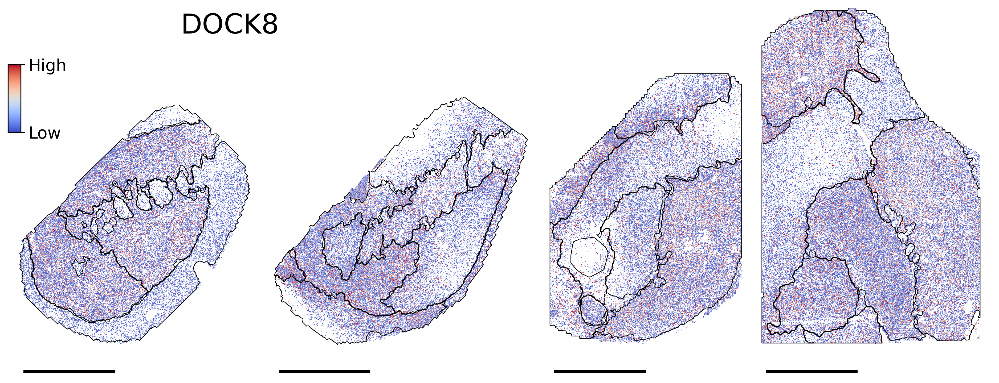

In [57]:
# define canvas for each samples, figure size will be based on the proprotion of the actual tissue size.

# fig,ax = plt.subplots(1,1,dpi = 300, figsize = (15,7))
import seaborn as sns
import matplotlib.patches as patches
import os
import copy 
import matplotlib as mpl

rot_deg = {'Donor_1311_posterior':0, 'Donor_2724_anterior':-45,'Donor_2724_posterior':0,'Donor_3924_anterior':45} # rotation value for each sample 
reverse_coord = {'Donor_1311_posterior':False,'Donor_2724_anterior':True, 'Donor_2724_posterior':False,'Donor_3924_anterior':True }
invert_xaxis = {'Donor_1311_posterior':False,'Donor_2724_anterior':True,'Donor_2724_posterior':False,'Donor_3924_anterior':False }
invert_yaxis = {'Donor_1311_posterior':True,'Donor_2724_anterior':True,'Donor_2724_posterior':True,'Donor_3924_anterior':True}
backgd_sz = {'Donor_1311_posterior':0.002,'Donor_2724_anterior':0.002,'Donor_2724_posterior':0.002,'Donor_3924_anterior':0.002}
# spatial module dictionary
sptial_module_dict = {'Donor_1311_posterior':donor_1311_posterior_spatialModuleContours,'Donor_2724_anterior':donor_2427_anterior_spatialModuleContours,'Donor_2724_posterior':donor_2427_posterior_spatialModuleContours,'Donor_3924_anterior':donor_3924_anterior_spatialModuleContours}
Striosome_module_dict = {'Donor_1311_posterior':donor_1311_posterior_StriosomeContours,'Donor_2724_anterior':donor_2427_anterior_StriosomeContours,'Donor_2724_posterior':donor_2427_posterior_StriosomeContours,'Donor_3924_anterior':donor_3924_anterior_StriosomeContours}

# all_clusters_plot = ['GPe-NDB-SI LHX6-LHX8-GBX1 GABA', 'SN-VTR-HTH GATA3-TCF7L2 GABA','STR FS PTHLH-PVALB GABA', 'STR-BF TAC3-PLPP4-LHX8 GABA','STRd D2 StrioMat Hybrid MSN']
# all_clusters_plot = [ 'STRd D2 Striosome MSN','STRd D2 Matrix MSN','STRv D2 MSN']
genes_toPlot = ['DOCK8']
for gn in genes_toPlot:

    fig = plt.figure(dpi = 300, figsize = (dx_max,dy_max))
    bbox = fig.get_tightbbox()
    ax = None

    samples = ['Donor_3924_anterior','Donor_2724_anterior','Donor_2724_posterior','Donor_1311_posterior']
    # samples = ['Donor_2724_posterior','Donor_1311_posterior']
    for sampleIdx,sample in enumerate(samples):
        cond = final_filtered_adata.obs['samples'] == sample
        # adjucent the spatial coordinate 
        X_sample = final_filtered_adata[cond].obsm['X_spatial'].copy()
        X_sample = rotate(X_sample,rot_deg[sample])
        cnt = copy.deepcopy(sptial_module_dict[sample])
        strio_cnt = Striosome_module_dict[sample]['Striosome'].copy()
        
        for label_ in cnt:
            if isinstance(cnt[label_],list):
                for i in range(len(cnt[label_])):
                    cnt[label_][i] = rotate(cnt[label_][i],rot_deg[sample])
            else:   
                cnt[label_] = rotate(cnt[label_],rot_deg[sample])
        for idx in range(len(strio_cnt)):
            strio_cnt[idx] = rotate(strio_cnt[idx],rot_deg[sample])

        if reverse_coord[sample]:
            X_sample = X_sample[:,::-1]
            for label_ in cnt:
                if isinstance(cnt[label_],list):
                    for i in range(len(cnt[label_])):
                        cnt[label_][i] = cnt[label_][i][:,::-1]
                else:
                    cnt[label_] = cnt[label_][:,::-1]
            for idx in range(len(strio_cnt)):
                strio_cnt[idx] = strio_cnt[idx][:,::-1]

        final_filtered_adata.obs.loc[cond,['x','y']] = X_sample.copy()
        # idenity the proprotion betwen the width and height of the sample
        dx,dy = np.abs(np.ptp(X_sample, axis = 0))
        if ax != None:
            bbox = ax.get_position()
        dx = dx/figsize_scale
        dy = dy/figsize_scale
        # calculate fraction of the new x and y size as fraction of the previous axis x and y size. we are doing this because, fig.add_axes accept values as fraction of the figure width and hight, 
        dx_frac = dx/fig.get_figwidth()
        dy_frac = dy/fig.get_figheight()
        width_gap = 1
        # if sampleIdx < 2:
        #     width_gap = 0.8
        # #     point_sz_map[all_clusters_plot[0]] = 1
        # #     point_sz_map[all_clusters_plot[1]] = 1
        #     # point_sz_map[all_clusters_plot[2]] = 1
        # elif sampleIdx < 3:
        #     width_gap = 0.9

        ax = fig.add_axes([bbox.xmin + width_gap*bbox.width,bbox.ymin,dx_frac, dy_frac], adjustable = 'box')
        # Plot the gene expression spatial map

        exp = final_filtered_adata[cond][:,gn].layers['log_count']
        M = np.percentile(exp,99)
        m = np.percentile(exp,1)
        expN = (exp - m)/(M-m)
        expN_ = np.clip(expN,0,1)
        szmax = 1#0.7
        szmin = 0.4
        sz = szmin + expN_*(szmax - szmin)
        cmap = mpl.cm.coolwarm(expN_)
        sns.scatterplot(x = X_sample[:,0], y = X_sample[:,1], s = sz.ravel(), c = cmap, ax = ax) # expression map of gene
        ax.set_axis_off()
        # plot_cluster_scdata(final_filtered_adata[cond],cluster_cmap,all_clusters = [cluster_],clusters = [cluster_],bg_color = 'gray',bg_pt_size = backgd_sz[sample], point_sz_map = point_sz_map, transpose=1,flipx=1,flipy=1,hue_input = 'Cluster_name' , ax = ax,use_seaborn = True,show_title = False )

        # add the outregion outlines 
        for label_ in ['Caudate','Putamen','NAC_shell','NAC_core','Gpi','Gpe','Internal_Capsule','BNST','anterior_commissure','Thalamus','whitematter(Olfactory area)','IsCj']:
            if label_ in cnt:
                if isinstance(cnt[label_],list):
                    for i in range(len(cnt[label_])):
                        ax.plot(cnt[label_][i][:,0],cnt[label_][i][:,1], lw = 0.6, c = 'k')
                else:
                    ax.plot(cnt[label_][:,0],cnt[label_][:,1], lw = 0.6, c = 'k')
        # add the striosome contour outline
        # for cnt in strio_cnt:
        #     ax.scatter(cnt[:,0],cnt[:,1], s = 0.01, c = 'k')      

        # Set the axis limits 
        xmax, ymax = X_sample.max(axis=0)
        xmin, ymin = X_sample.min(axis=0)
        # ax.set_xlim([xmin,xmax])
        ax.set_ylim([ymin,ymax + 3500])
        # add scale bar
        # add scale bar
        if sample == 'Donor_2724_anterior':
            scalebar = patches.Rectangle([xmax - 500,1*ymax + 3000],-10000,200,color = 'k')
        else:    
            scalebar = patches.Rectangle([xmin + 500,1*ymax + 3000],10000,200,color = 'k')
        
        ax.add_patch(scalebar)
        
        if invert_xaxis[sample]:
            ax.invert_xaxis()
        
        if invert_yaxis[sample]:
            ax.invert_yaxis()
        # ax.set_aspect('equal', adjustable ='datalim')
        if sampleIdx == 0:
            ax.text(xmin + 0.7*np.ptp(X_sample[:,0]), ymin - 0.3*np.ptp(X_sample[:,1]), f'{gn}', fontsize = 25, color = 'k')
            # add axes for the colorbar 
            bbox = ax.get_position()
            ax_cbar = fig.add_axes([bbox.xmin, bbox.ymin + 0.9*bbox.height, 0.05*bbox.width,0.25*bbox.height])
            norm = mpl.colors.Normalize(vmin=0, vmax=1)
            fig.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap='coolwarm'), cax=ax_cbar,)
            ax_cbar.set_yticks([1,0],labels = ['High','Low'],fontsize = 15)

    file_name = '_'.join([x for x in f'{gn}'.replace(' ','_').split('-') ])
    plt.savefig(r'./figures/Custom_AstroCluster_Mainfigure_panels/supplemental' + os.sep + file_name + '.png',bbox_inches = 'tight')
    plt.savefig(r'./figures/Custom_AstroCluster_Mainfigure_panels/supplemental' + os.sep + file_name + '.tif',bbox_inches = 'tight')

    plt.show()